<a href="https://colab.research.google.com/github/danielsoy/AutoEncoder-SSIM-for-unsupervised-anomaly-detection-/blob/master/botella_MvTec_kaggle_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# UNSUPERVISED ANOMALY SEGMENTATION
### This is a implementation of **DFR: Deep Feature Reconstruction for Unsupervised Anomaly Segmentation** https://arxiv.org/abs/2012.07122
#### We train only with OK images, and then we predict a hotmap, where high areas are presumably anomalous
#### The pretrained weights provided by me (input anomalysegmentation-weights) are not very good because Kaggle limits training time to 9hrs

## IMPORTS

In [19]:
!pip install tqdm

In [20]:
import tensorflow as tf  
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras import Input, Model, Sequential
from tensorflow.keras import layers

from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA

from skimage import io
from skimage.transform import resize

import numpy as np

from matplotlib import pyplot as plt
import matplotlib.pyplot as plt
import cv2

import random
import os
from tqdm import tqdm

from random import randrange

In [21]:
from google.colab import drive

In [22]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Custom Data Generator

In [23]:
class CustomDataGen(tf.keras.utils.Sequence):
    
    def __init__(self, path = "../content/drive/MyDrive/input botella/mvtecad-mvtec-anomaly-detection/mvtec_anomaly_detection/botella/",
                 batch_size = 4,
                 input_size=(224, 224),
                 shuffle=True, seed = None, subset = 'training'):
        
        self.image_data_generator = ImageDataGenerator(rescale=1. / 255, data_format='channels_last',     
            #zoom_range = 0.1,
            #width_shift_range = 0.05,
            #height_shift_range = 0.05,
            #brightness_range=(0.95,1.05)
        )
        
        if seed is None:
            random.randint(0, 2**32)
            
        self.batch_size = batch_size
        self.input_size = input_size
        
        self.X_paths = [os.fsdecode(file) for file in os.scandir(f"{path}/train/good")]
        self.X_train, self.X_val = train_test_split(self.X_paths, test_size=0.2, random_state = seed, shuffle = True)
        
        if subset == 'training':            
            self.X = self.X_train
        elif subset == 'validation':
            self.X = self.X_val
            
        self.n = len(self.X)
    
    
    def __getitem__(self, index):
        
        data_x = []
        
        for i in range(self.batch_size):
            image = cv2.imread(self.X[self.batch_size * index + i])
            
            image = self.image_data_generator.random_transform(image)
            
            image = image / 255
            
            image = tf.image.resize(image, self.input_size)
            data_x.append(image)
            
        data_x = np.array(data_x)
        
        return data_x, data_x
    
    def __len__(self):            
        return self.n // self.batch_size

In [24]:
INPUT_SIZE = (224,224)
seed = random.randint(0, 2**32)
train_datagen = CustomDataGen(input_size = INPUT_SIZE, batch_size = 4, seed = seed)
validation_datagen = CustomDataGen(input_size = INPUT_SIZE, subset = "validation", seed = seed) 

In [25]:
#Check we dont have the same images in train and validation sets
any([value in train_datagen.X for value in validation_datagen.X])

False

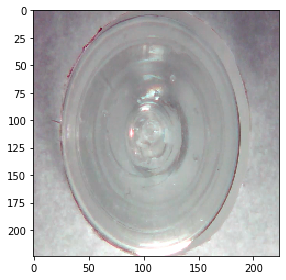

In [26]:
x, y = train_datagen[0]
io.imshow(x[0])
io.show()

## Model

In [27]:
input_model_filepath = "../input/anomalysegmentation-weights/anomaly-segmentation-model_vgg19.h5"
output_model_filepath = "./anomaly-segmentation-model.h5"
#model class
#Implementation of DFR: Deep Feature Reconstruction for Unsupervised Anomaly Segmentation https://arxiv.org/abs/2012.07122
class AnomalySegmentator(tf.keras.Model):
    def __init__(self, init_layer = 0, end_layer = None):
        super(AnomalySegmentator, self).__init__()
        #self.L2_weight = 1e-6
        self.init_layer = init_layer
        self.end_layer = end_layer
        
    def build_autoencoder(self, c0, cd):
        self.autoencoder = Sequential([
            layers.InputLayer((self.map_shape[0]//4, self.map_shape[1]//4, c0)),
            layers.Conv2D((c0 + cd) // 2,(1,1), padding='same', activation = tf.keras.layers.LeakyReLU(alpha=0.1)),
            layers.Conv2D(2*cd,(1,1), padding='same', activation = tf.keras.layers.LeakyReLU(alpha=0.1)),
            layers.Conv2D(cd,(1,1), padding='same'),
            layers.Conv2D(2*cd,(1,1), padding='same', activation = tf.keras.layers.LeakyReLU(alpha=0.1)),
            layers.Conv2D((c0 + cd) // 2,(1,1), padding='same', activation = tf.keras.layers.LeakyReLU(alpha=0.1)),
            layers.Conv2D(c0,(1,1), padding='same')            
            
        ])
        
    def build(self, input_shape):
        
        self.vgg = VGG19(include_top = False, weights = 'imagenet', input_shape=input_shape[1:])
        self.features_list = [layer.output for layer in self.vgg.layers if 'conv' in layer.name][self.init_layer:self.end_layer]
        
        self.feature_extractor = Model(inputs = self.vgg.input, 
                                       outputs = self.features_list)
        self.feature_extractor.trainable = False   
        
        self.threshold = tf.Variable(0, trainable = False, dtype = tf.float32)

        self.map_shape = self.features_list[0].shape[1:-1]
        
        self.average_pooling = layers.AveragePooling2D(pool_size=(4, 4), strides=(4,4))       
        
        
        
        self.c0 = sum([feature.shape[-1] for feature in self.features_list])        
        self.cd = 40        
        self.build_autoencoder(self.c0, self.cd)
        
          
    def call(self, inputs):
        features = self.feature_extractor(inputs)
        resized_features = [tf.image.resize(feature, self.map_shape) for feature in features]
        resized_features = tf.concat(resized_features, axis = -1)
        
        resized_features = self.average_pooling(resized_features)

        autoencoder_output = self.autoencoder(resized_features)
        return tf.reduce_sum((autoencoder_output - resized_features)**2, axis = -1)
        
    def reconstruction_loss(self):
        @tf.function
        def _loss(y_true, y_pred):
            loss = tf.reduce_mean(y_pred, axis = (1,2)) / (tf.cast(tf.shape(y_pred)[0], tf.float32) * self.c0)
            return loss
                    
        return _loss

    def compute_threshold(self, data_loader, fpr = 0.05):
      error = []
      for i in tqdm(range(len(data_loader))):
        x, y = data_loader[i]
        error.append(self(x))

      threshold = np.percentile(error, 100 - fpr)
      self.threshold = tf.Variable(threshold, trainable = False, dtype = tf.float32)
        
    def compute_pca(self, data_loader):
        extraction_per_sample = 20
        
        extractions = []        
        for i in tqdm(range(len(data_loader))):
            x, _ = data_loader[i]     
            
            features = self.feature_extractor(x)
            resized_features = [tf.image.resize(feature, self.map_shape) for feature in features]
            resized_features = tf.concat(resized_features, axis = -1)

            resized_features = self.average_pooling(resized_features)
            
            for feature in resized_features:
                
                for _ in range(extraction_per_sample):                    
                
                    row, col = randrange(feature.shape[0]), randrange(feature.shape[1])
                    extraction = feature[row, col]
                    extractions.append(extraction)
            
        extractions = np.array(extractions)
        print(f"Extractions Shape: {extractions.shape}")
        pca = PCA(0.9, svd_solver = "full")
        pca.fit(extractions)
        self.cd = pca.n_components_
        self.build_autoencoder(self.c0, self.cd)
        print(f"Components with explainable variance 0.9 -> {self.cd}")
        
as_model = AnomalySegmentator()
as_model.compile(Adam(1e-4), loss = as_model.reconstruction_loss())

In [28]:
as_model.build((None, *INPUT_SIZE,3))
as_model.compute_pca(train_datagen)

100%|██████████| 30/30 [04:09<00:00,  8.31s/it]


Extractions Shape: (2400, 5504)
Components with explainable variance 0.9 -> 39


## Training

30/30 [==============================] - 1294s 43s/step - loss: 6.7268 - val_loss: 3.3056 - lr: 1.0000e-04


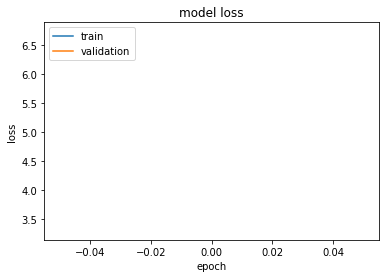

100%|██████████| 30/30 [10:03<00:00, 20.11s/it]


In [29]:
#True if we want to train the model
if True:
    # Training the model
    plateau = tf.keras.callbacks.ReduceLROnPlateau(
      monitor='val_loss', factor=0.5, patience=5, verbose = 1
    )
    es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', verbose=1,
                                          patience=15)  # Early stopping (stops training when validation doesn't improve for {patience} epochs)
    save_best = tf.keras.callbacks.ModelCheckpoint(output_model_filepath, monitor='val_loss', save_best_only=True,
                                                mode='min', save_weights_only = True)  # Saves the best version of the model to disk (as measured on the validation data set)
          
    history = as_model.fit(train_datagen,
        epochs=1,
        validation_data=validation_datagen,
        shuffle=True,
        callbacks=[es, save_best, plateau])
    #Training history
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'validation'], loc='upper left')
    plt.show()
    
    as_model.load_weights(output_model_filepath)
    as_model.compute_threshold(train_datagen)
    as_model.save_weights(output_model_filepath)
else:
    
    as_model.build((None, *INPUT_SIZE,3))
    as_model.load_weights(input_model_filepath)
    as_model.compute_threshold(train_datagen)
    as_model.summary()
    as_model.autoencoder.summary()

# TESTING

In [30]:
classes = ['good', 'manipulated_front', 'scratch_head', 'scratch_neck', 'thread_side', 'thread_top'] #only 0 index is GOOD
test_datagen = ImageDataGenerator(rescale=1. / 255, data_format='channels_last')
test_generator = test_datagen.flow_from_directory("../content/drive/MyDrive/input botella/mvtecad-mvtec-anomaly-detection/mvtec_anomaly_detection/botella/test", 
                                                  target_size = INPUT_SIZE,
                                                  batch_size = 1,
                                                  class_mode = 'sparse')

##  /content/drive/MyDrive/input botella/mvtecad-mvtec-anomaly-detection/mvtec_anomaly_detection/botella/test

Found 163 images belonging to 6 classes.


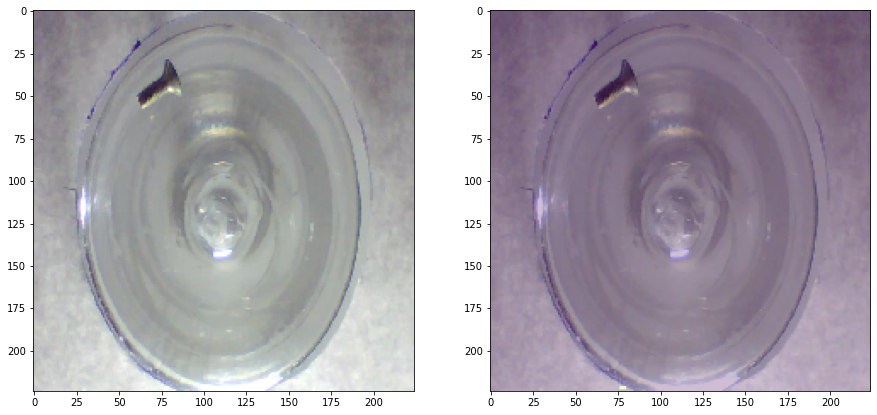

Threshold: 384923.6875 MaxValue: 388094.65625
GT: scratch_head, anomaly detected: True


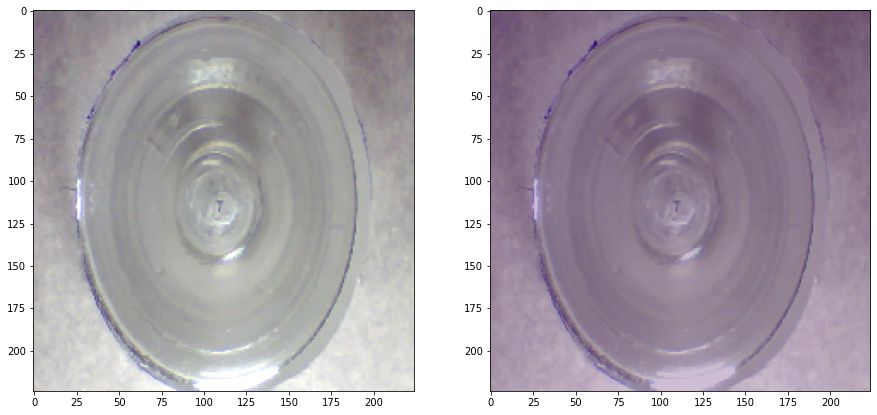

Threshold: 384923.6875 MaxValue: 374825.4375
GT: good, anomaly detected: True


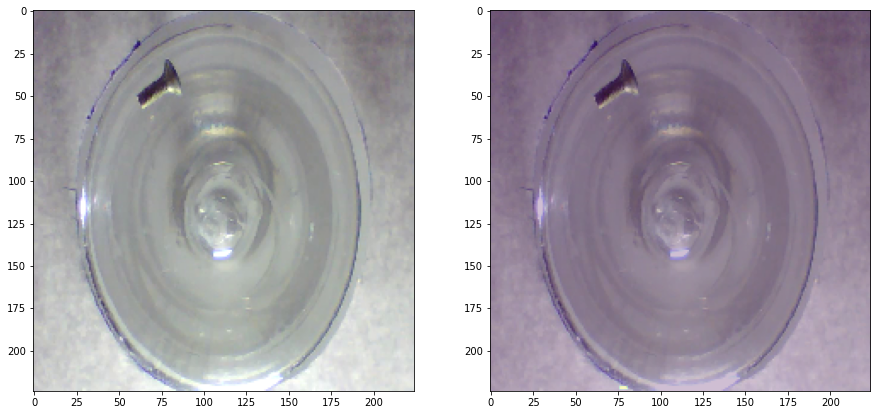

Threshold: 384923.6875 MaxValue: 389187.96875
GT: scratch_head, anomaly detected: True


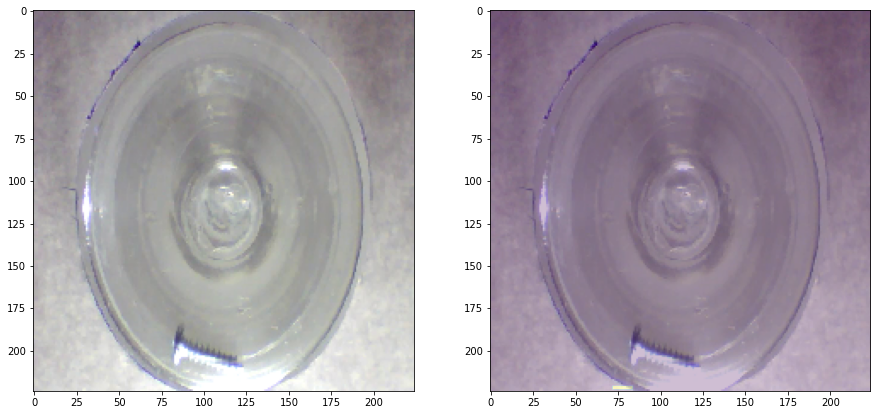

Threshold: 384923.6875 MaxValue: 409165.8125
GT: manipulated_front, anomaly detected: True


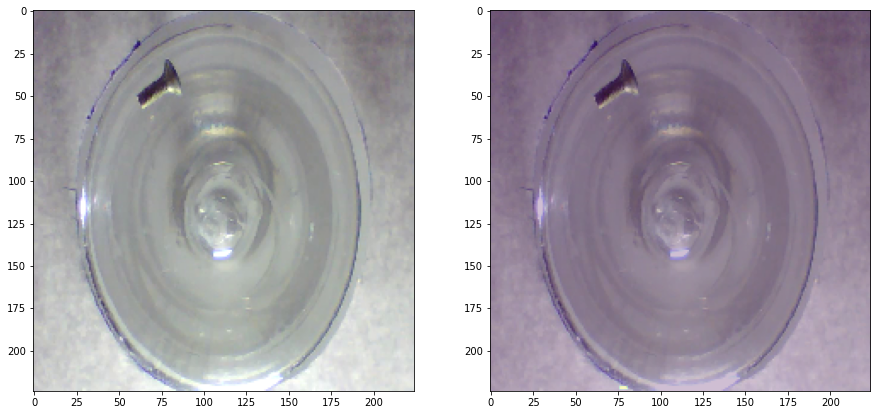

Threshold: 384923.6875 MaxValue: 389187.96875
GT: manipulated_front, anomaly detected: True


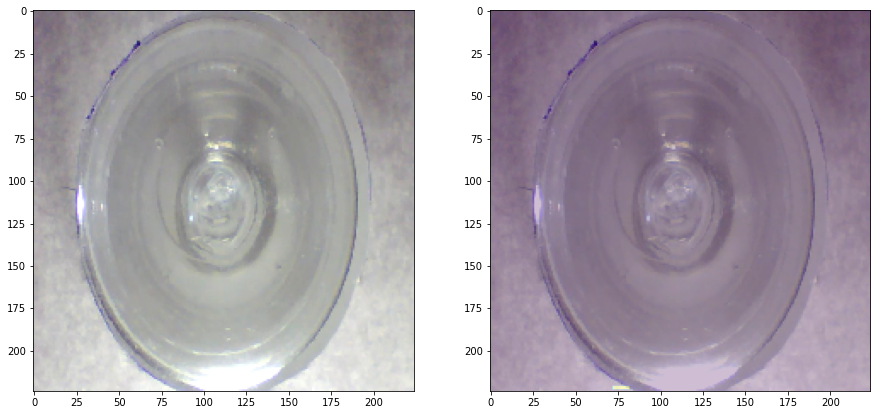

Threshold: 384923.6875 MaxValue: 407177.9375
GT: good, anomaly detected: True


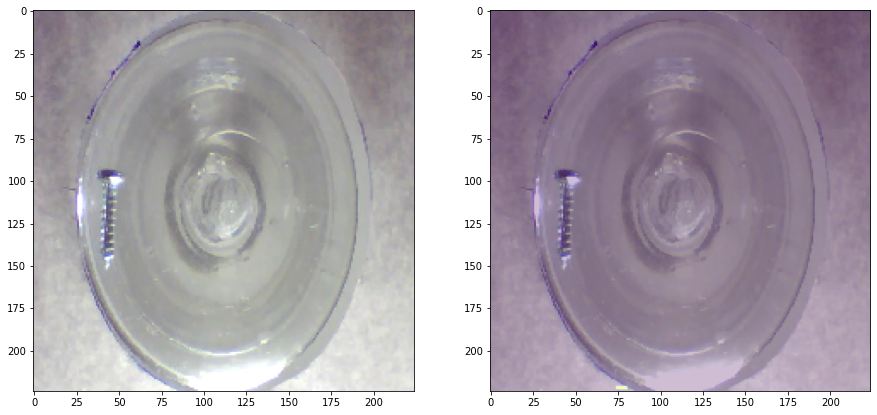

Threshold: 384923.6875 MaxValue: 392854.90625
GT: scratch_neck, anomaly detected: True


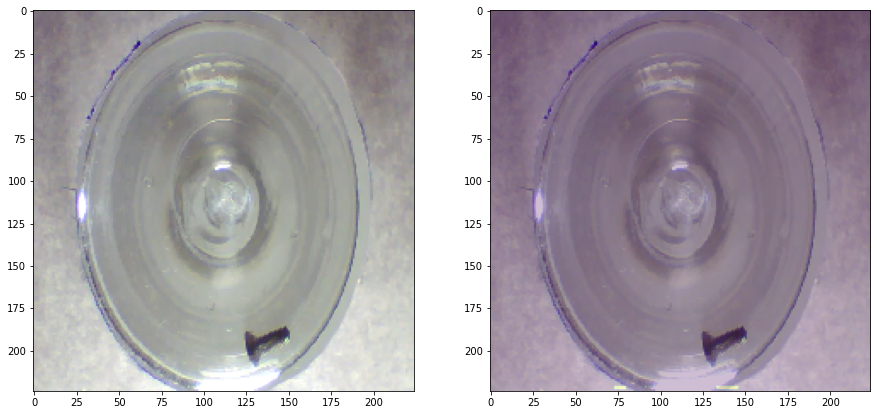

Threshold: 384923.6875 MaxValue: 410098.3125
GT: manipulated_front, anomaly detected: True


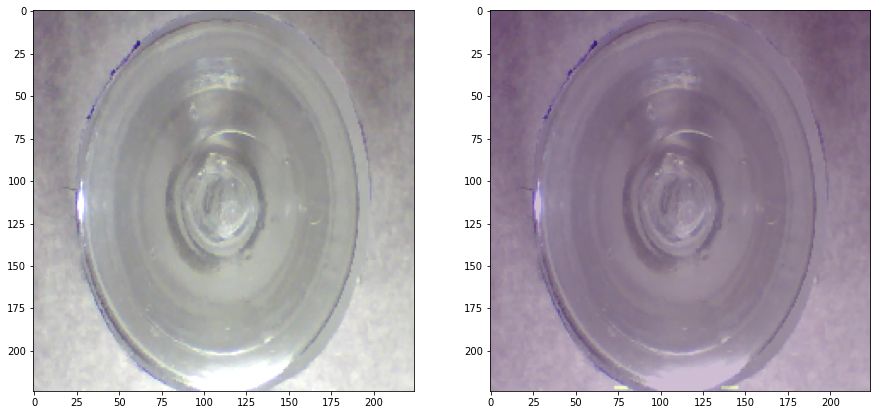

Threshold: 384923.6875 MaxValue: 402462.09375
GT: good, anomaly detected: True


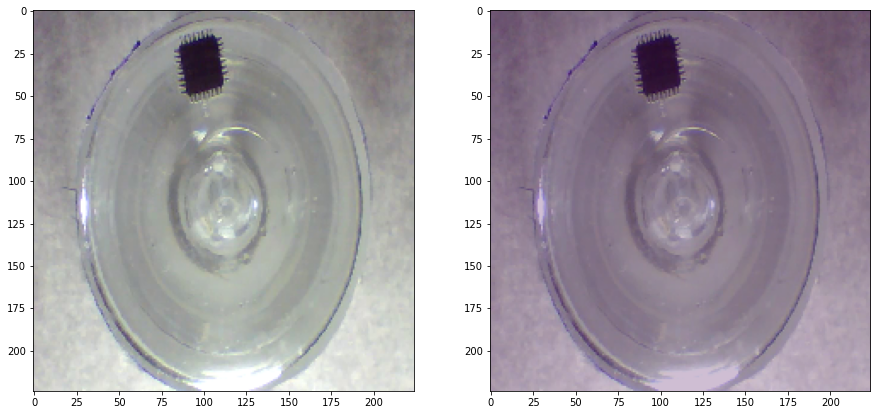

Threshold: 384923.6875 MaxValue: 383273.6875
GT: scratch_neck, anomaly detected: True


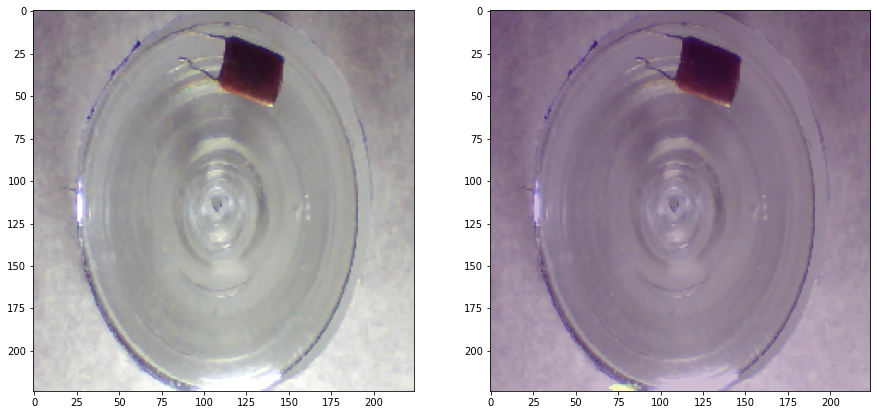

Threshold: 384923.6875 MaxValue: 445358.09375
GT: scratch_neck, anomaly detected: True


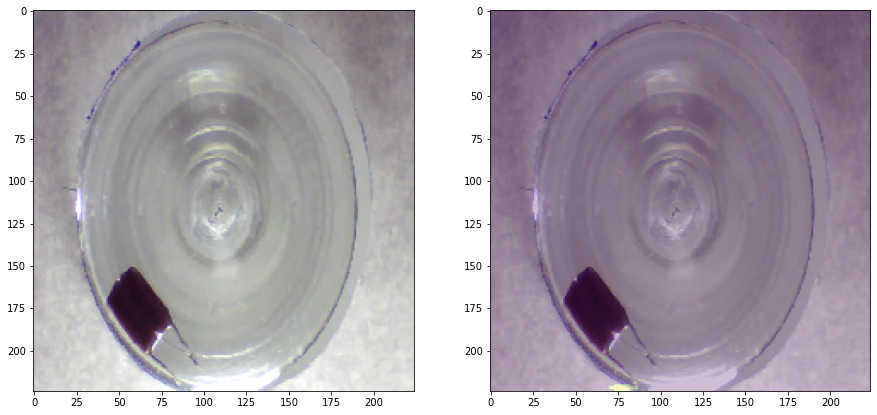

Threshold: 384923.6875 MaxValue: 430294.8125
GT: scratch_neck, anomaly detected: True


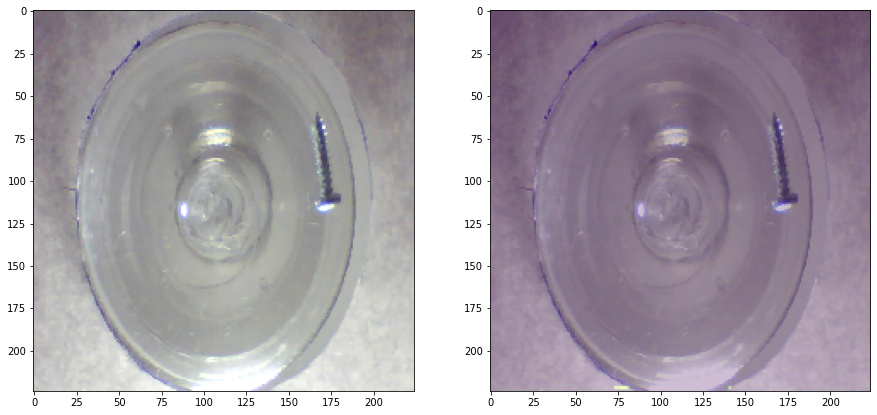

Threshold: 384923.6875 MaxValue: 399835.5
GT: manipulated_front, anomaly detected: True


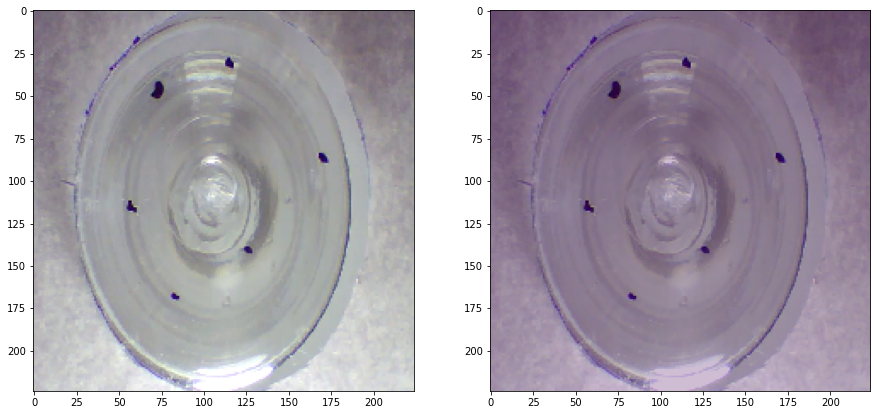

Threshold: 384923.6875 MaxValue: 372779.03125
GT: thread_side, anomaly detected: True


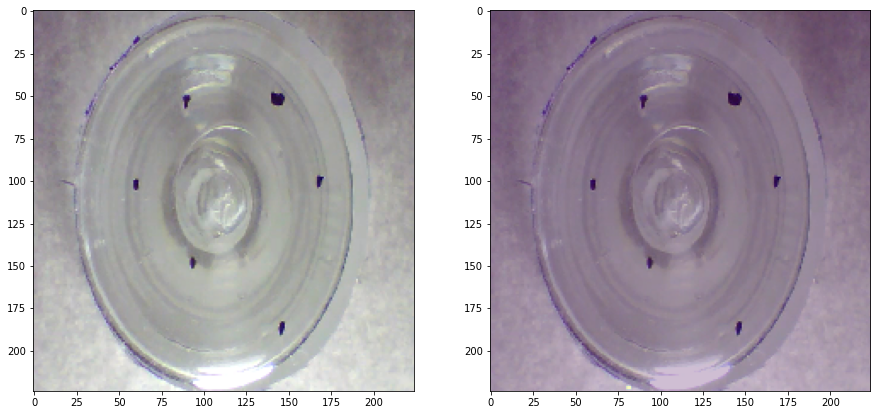

Threshold: 384923.6875 MaxValue: 387103.90625
GT: thread_side, anomaly detected: True


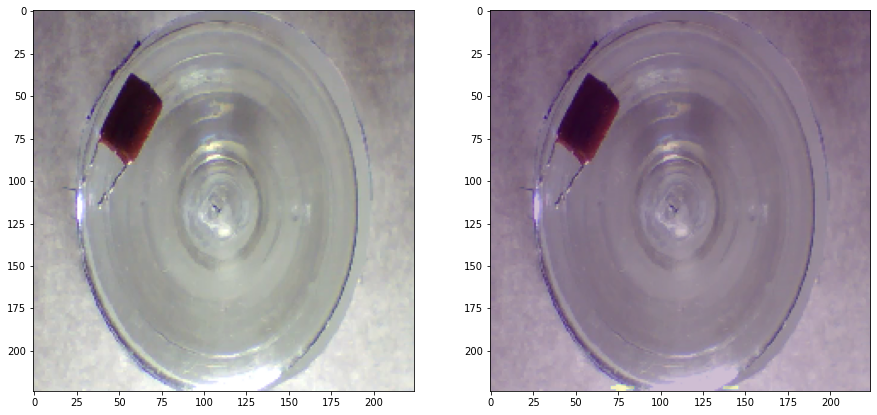

Threshold: 384923.6875 MaxValue: 419588.09375
GT: thread_top, anomaly detected: True


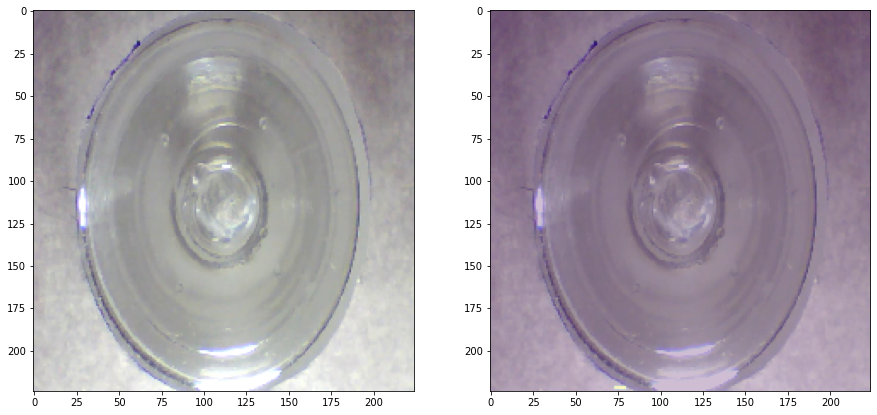

Threshold: 384923.6875 MaxValue: 394604.75
GT: good, anomaly detected: True


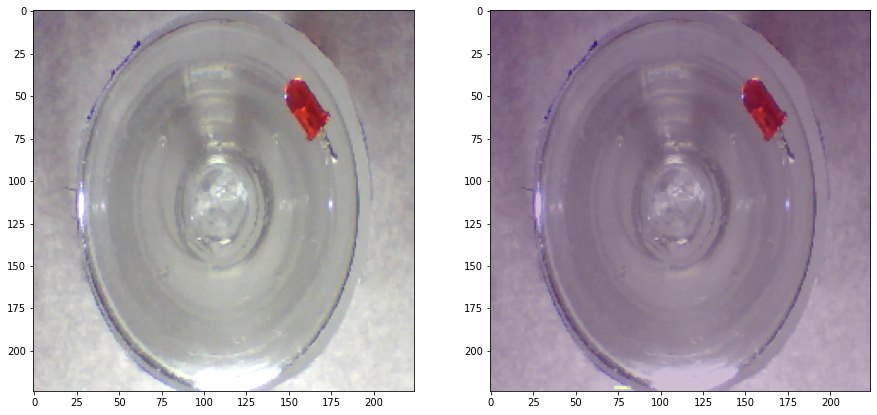

Threshold: 384923.6875 MaxValue: 402074.0
GT: scratch_neck, anomaly detected: True


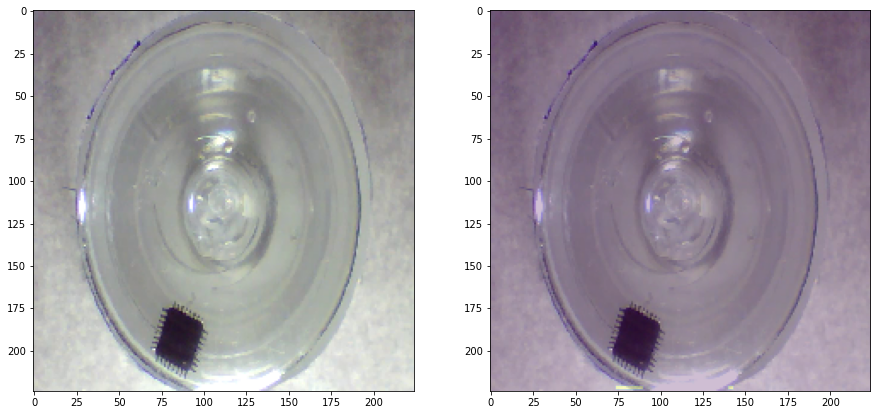

Threshold: 384923.6875 MaxValue: 404312.1875
GT: scratch_neck, anomaly detected: True


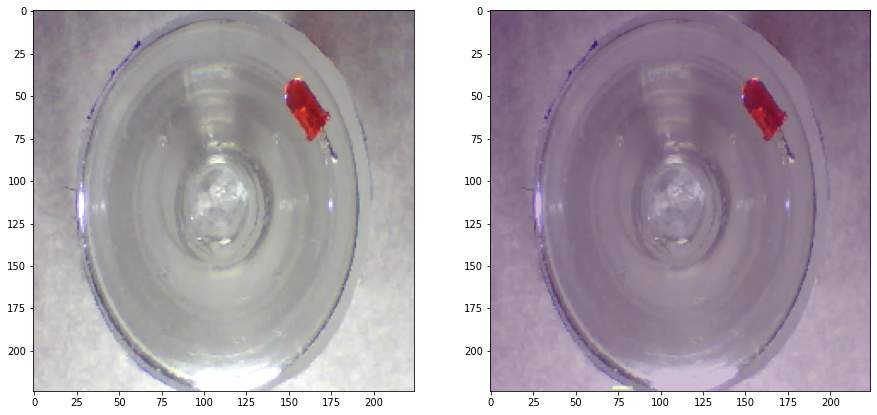

Threshold: 384923.6875 MaxValue: 405716.09375
GT: scratch_neck, anomaly detected: True


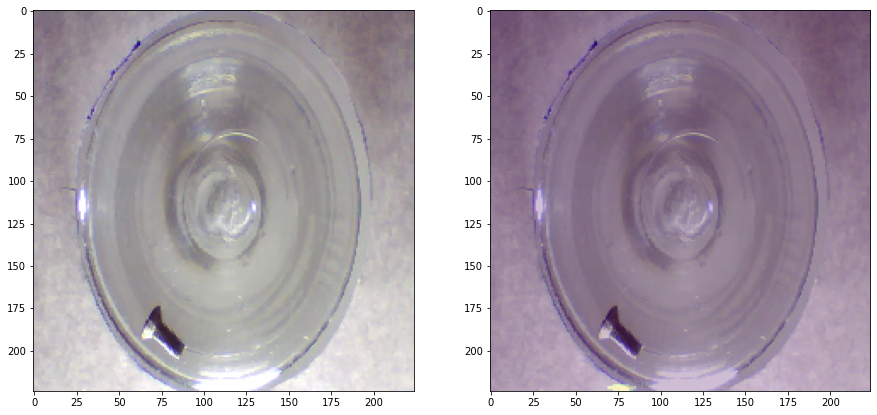

Threshold: 384923.6875 MaxValue: 433141.03125
GT: manipulated_front, anomaly detected: True


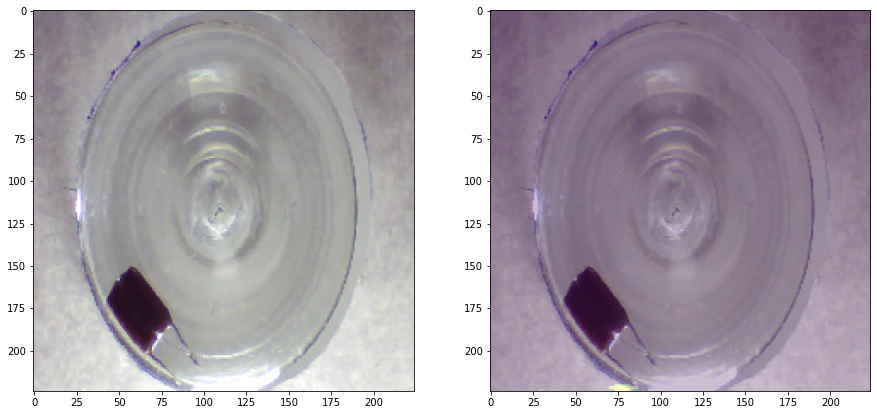

Threshold: 384923.6875 MaxValue: 429867.78125
GT: scratch_neck, anomaly detected: True


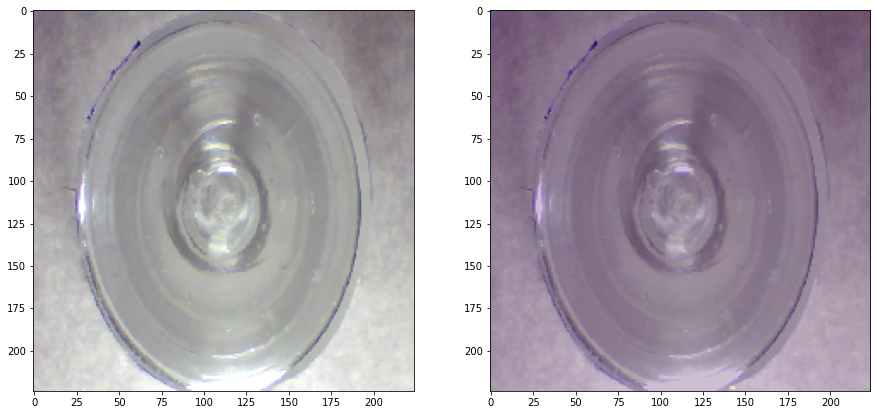

Threshold: 384923.6875 MaxValue: 389768.28125
GT: thread_top, anomaly detected: True


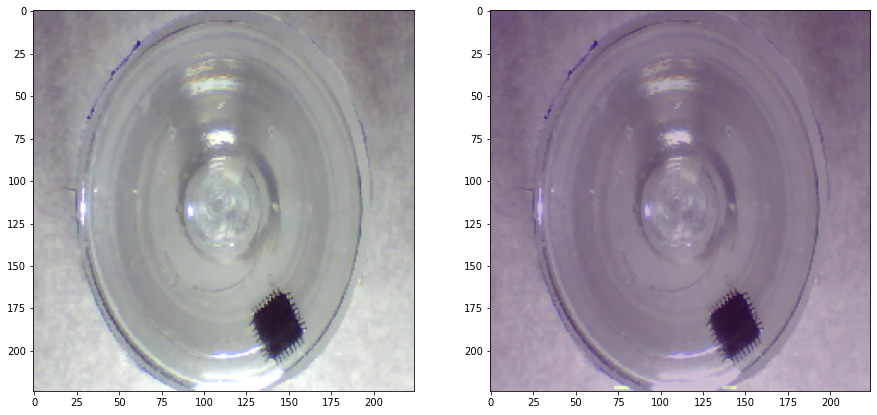

Threshold: 384923.6875 MaxValue: 400973.90625
GT: scratch_neck, anomaly detected: True


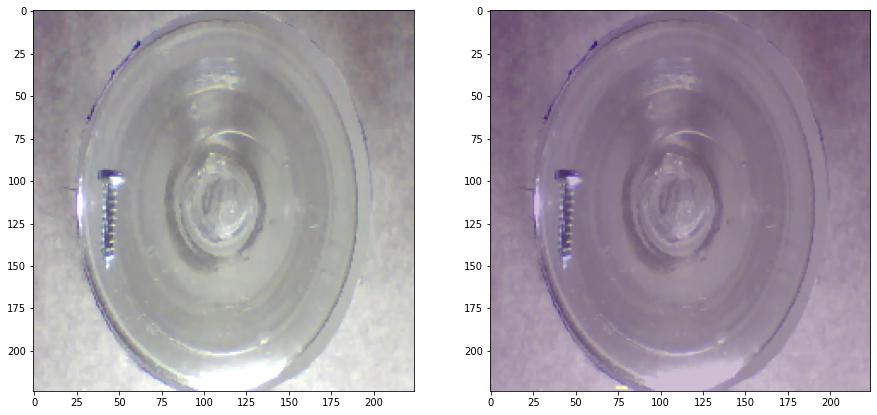

Threshold: 384923.6875 MaxValue: 394840.3125
GT: scratch_head, anomaly detected: True


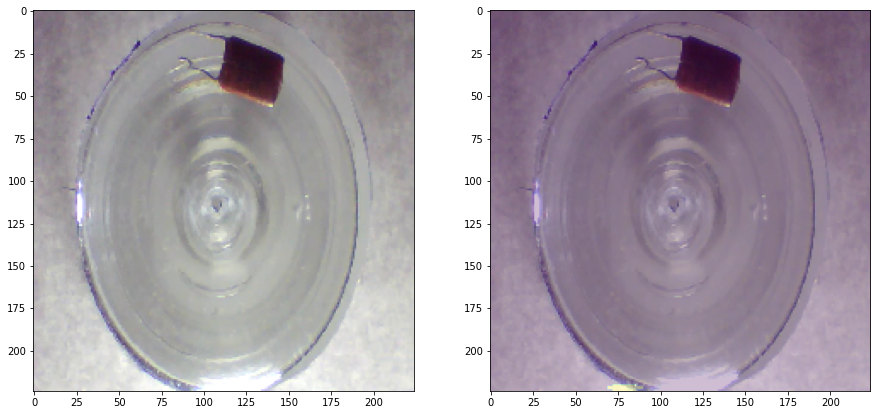

Threshold: 384923.6875 MaxValue: 445184.71875
GT: scratch_neck, anomaly detected: True


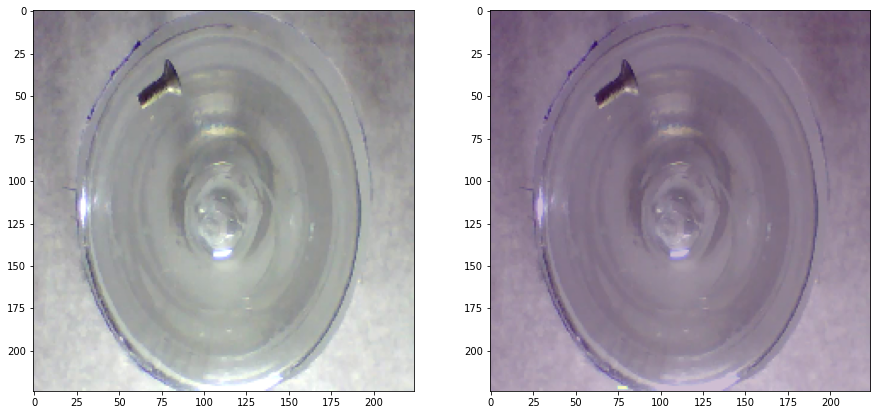

Threshold: 384923.6875 MaxValue: 390122.28125
GT: manipulated_front, anomaly detected: True


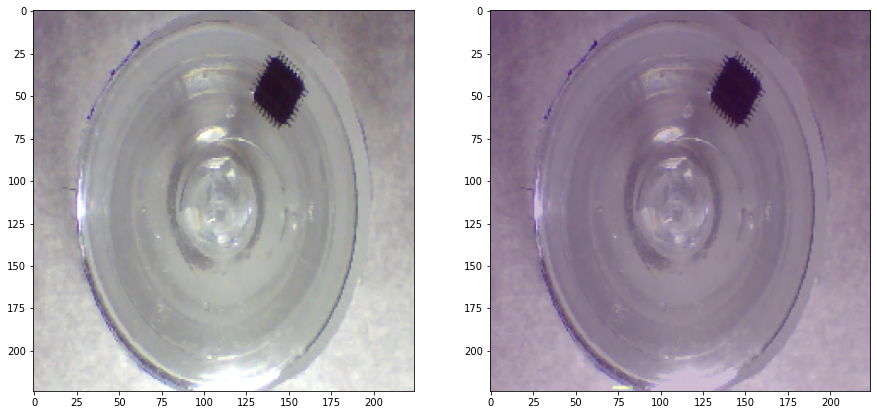

Threshold: 384923.6875 MaxValue: 408236.65625
GT: thread_side, anomaly detected: True


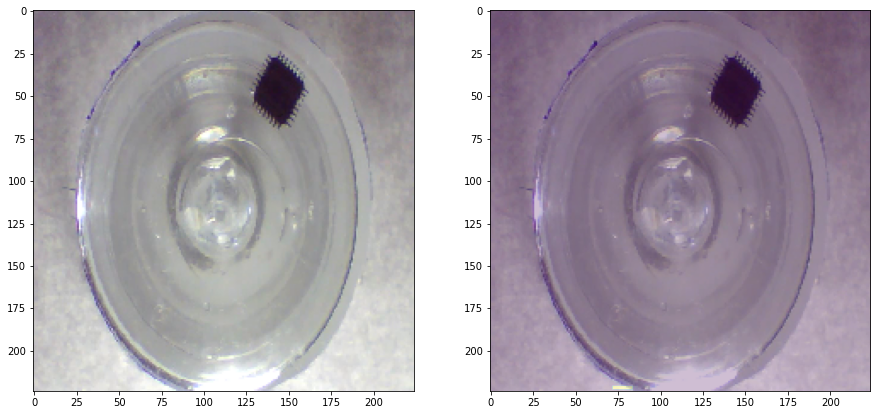

Threshold: 384923.6875 MaxValue: 410883.8125
GT: thread_side, anomaly detected: True


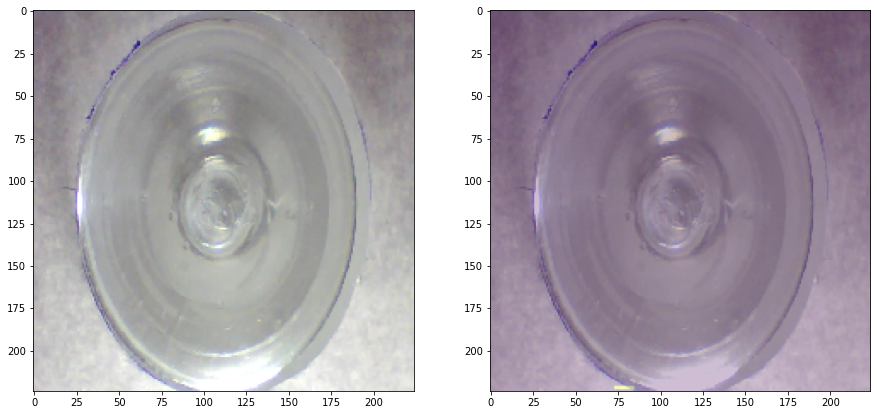

Threshold: 384923.6875 MaxValue: 402502.1875
GT: good, anomaly detected: True


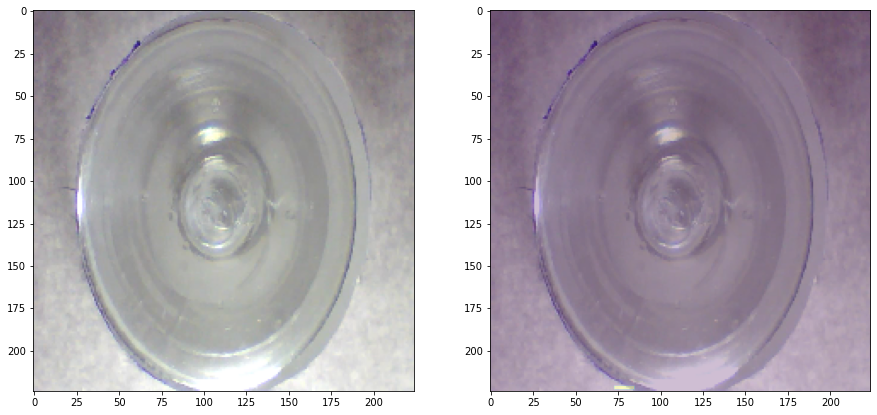

Threshold: 384923.6875 MaxValue: 401418.40625
GT: thread_top, anomaly detected: True


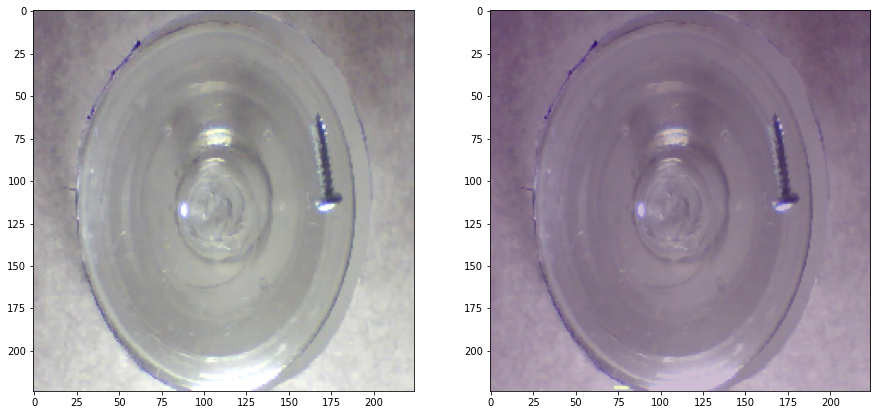

Threshold: 384923.6875 MaxValue: 399823.375
GT: scratch_head, anomaly detected: True


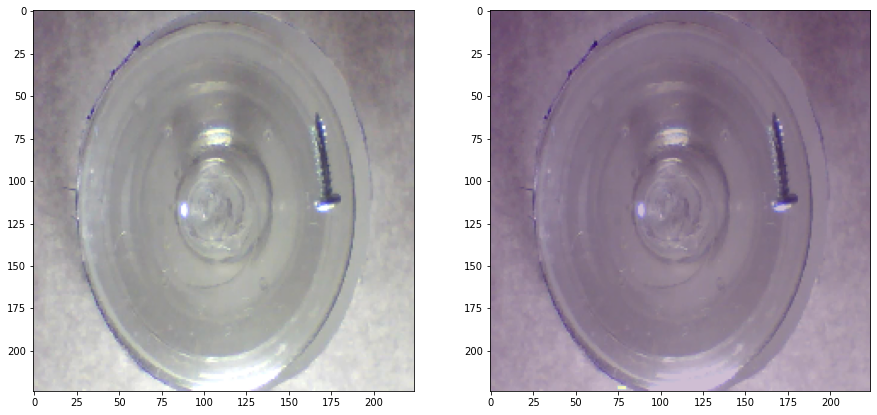

Threshold: 384923.6875 MaxValue: 391381.8125
GT: thread_top, anomaly detected: True


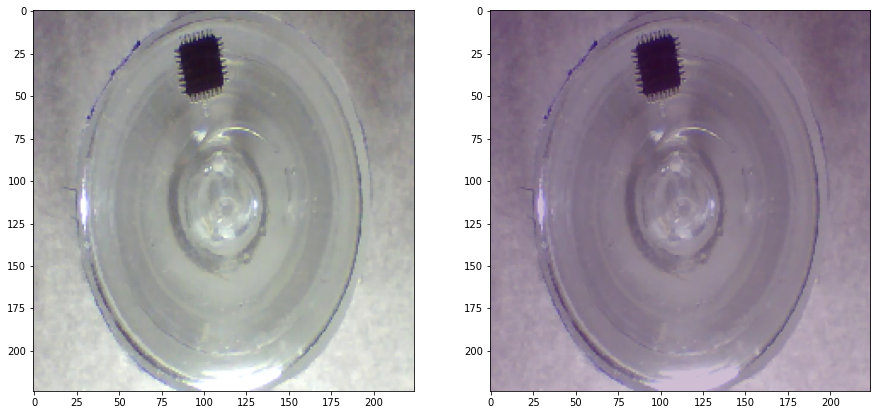

Threshold: 384923.6875 MaxValue: 380995.625
GT: scratch_neck, anomaly detected: True


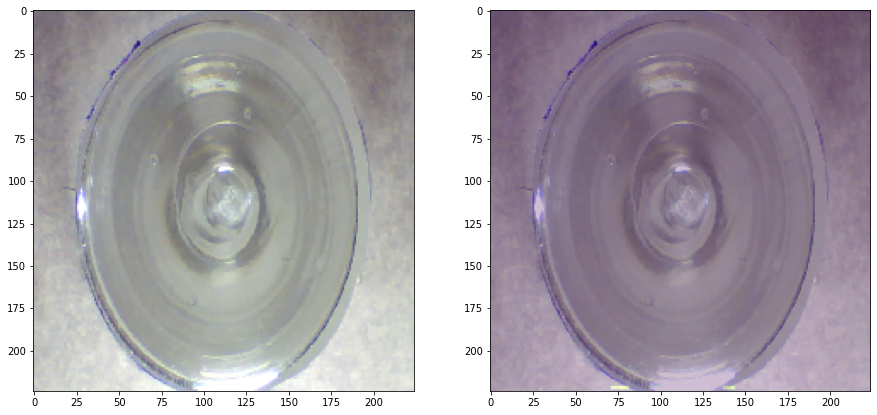

Threshold: 384923.6875 MaxValue: 406075.59375
GT: thread_top, anomaly detected: True


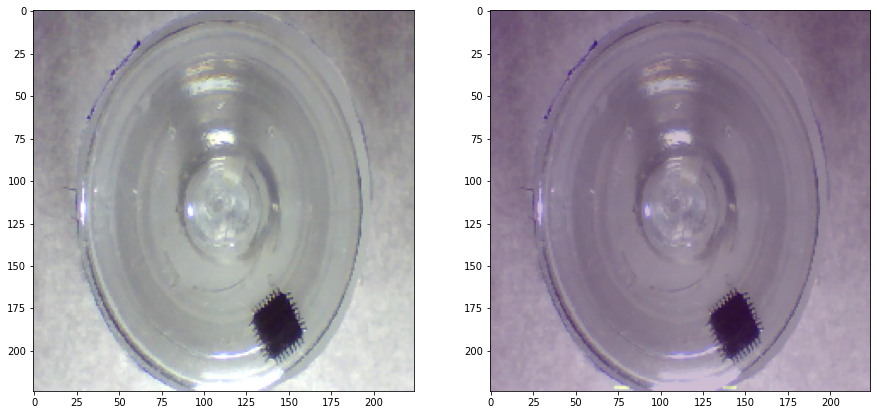

Threshold: 384923.6875 MaxValue: 399706.65625
GT: thread_side, anomaly detected: True


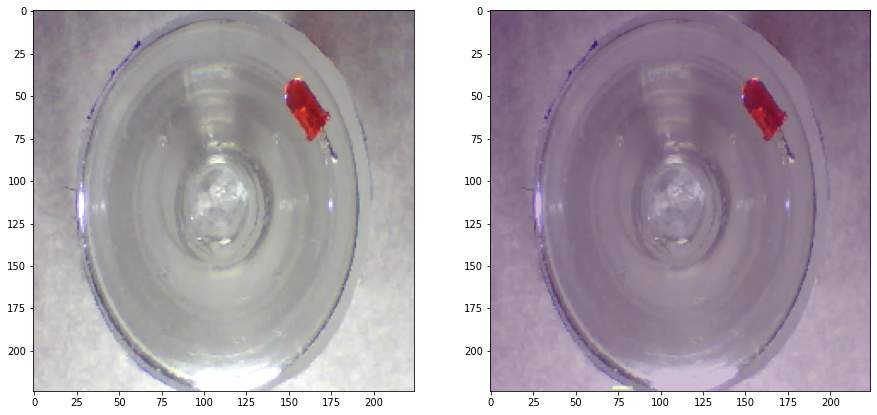

Threshold: 384923.6875 MaxValue: 405716.09375
GT: scratch_head, anomaly detected: True


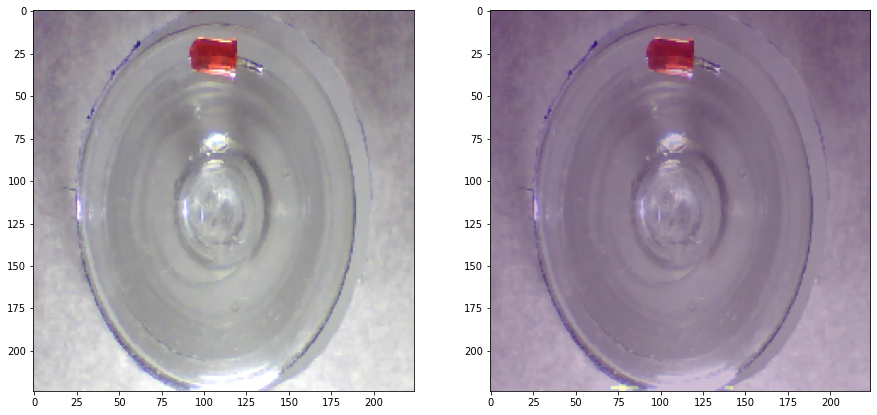

Threshold: 384923.6875 MaxValue: 418922.96875
GT: scratch_neck, anomaly detected: True


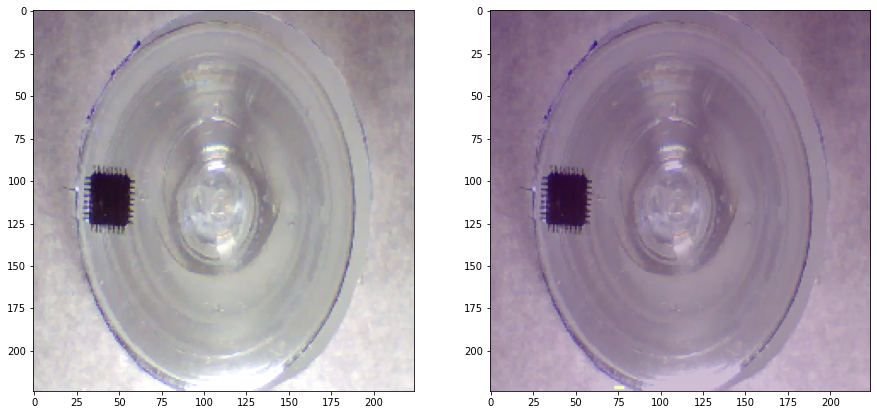

Threshold: 384923.6875 MaxValue: 389498.3125
GT: scratch_neck, anomaly detected: True


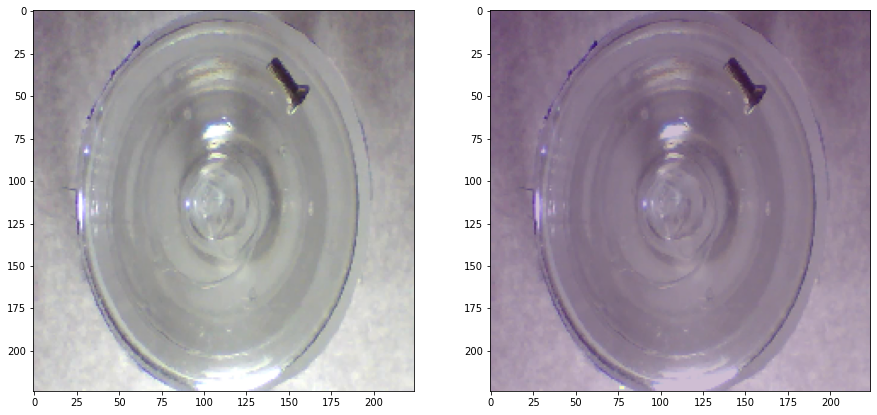

Threshold: 384923.6875 MaxValue: 388151.78125
GT: scratch_head, anomaly detected: True


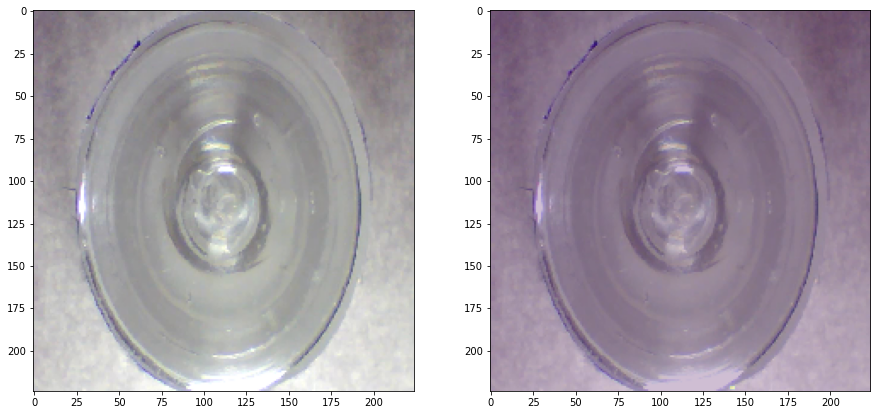

Threshold: 384923.6875 MaxValue: 390251.53125
GT: good, anomaly detected: True


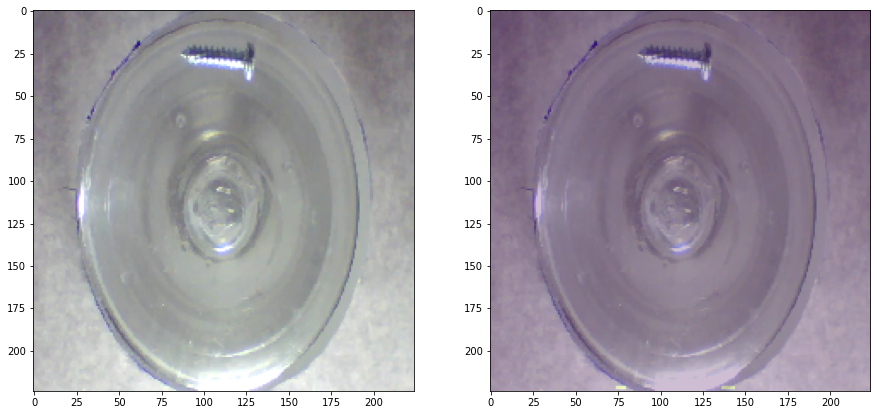

Threshold: 384923.6875 MaxValue: 394859.03125
GT: manipulated_front, anomaly detected: True


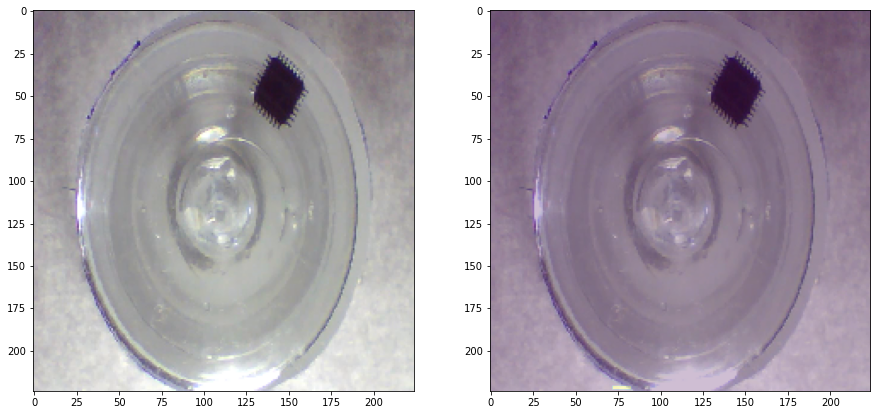

Threshold: 384923.6875 MaxValue: 404624.0625
GT: thread_side, anomaly detected: True


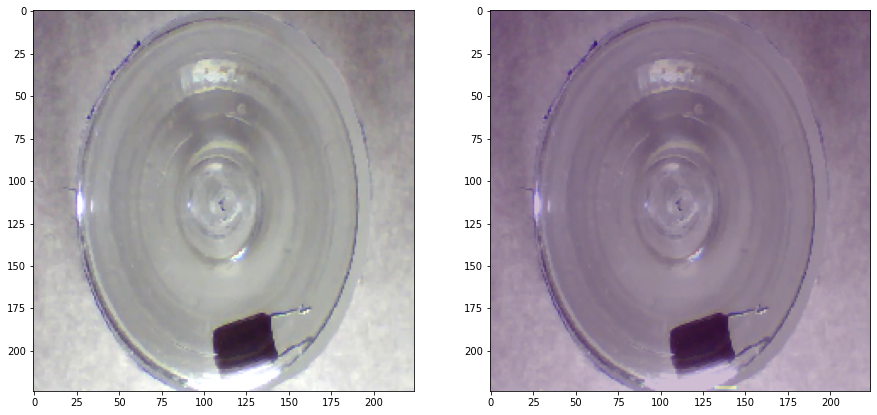

Threshold: 384923.6875 MaxValue: 402020.34375
GT: scratch_neck, anomaly detected: True


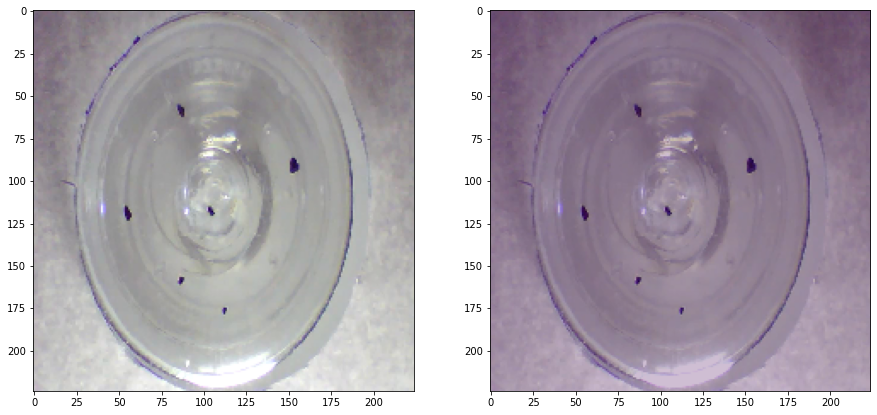

Threshold: 384923.6875 MaxValue: 365108.5
GT: thread_side, anomaly detected: False


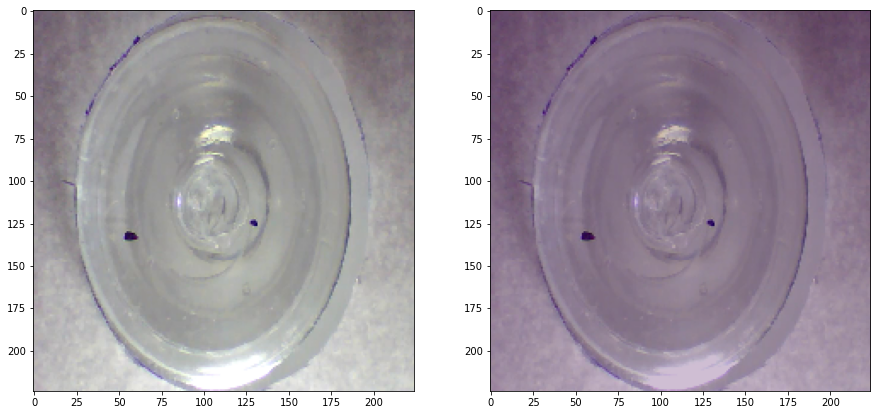

Threshold: 384923.6875 MaxValue: 382949.90625
GT: thread_top, anomaly detected: True


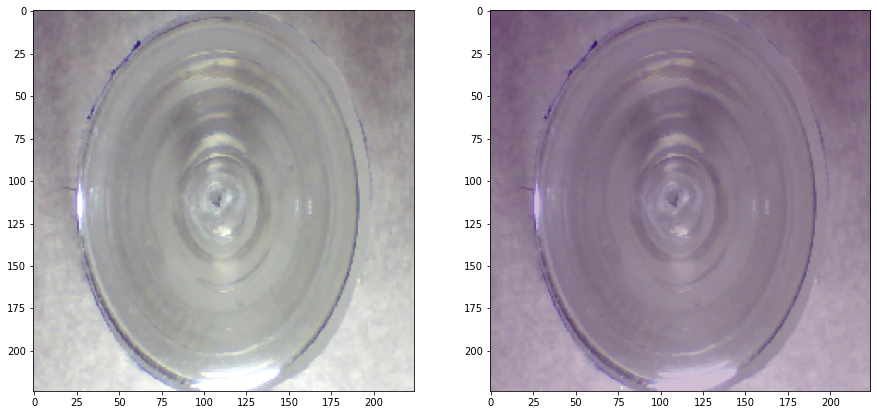

Threshold: 384923.6875 MaxValue: 385502.84375
GT: good, anomaly detected: True


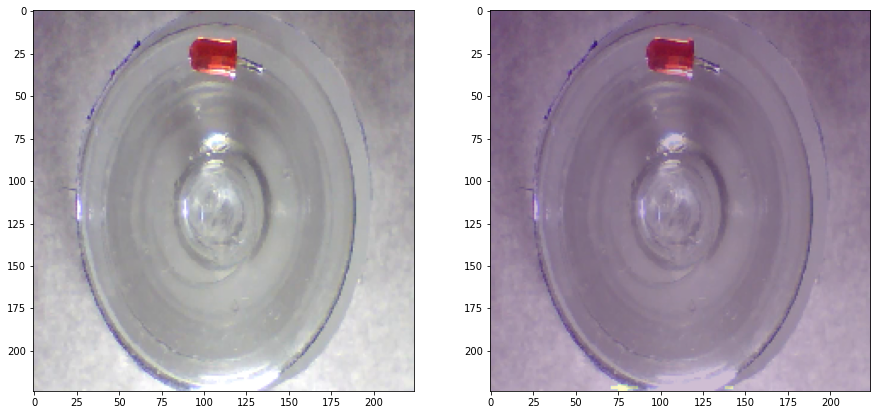

Threshold: 384923.6875 MaxValue: 422808.65625
GT: scratch_neck, anomaly detected: True


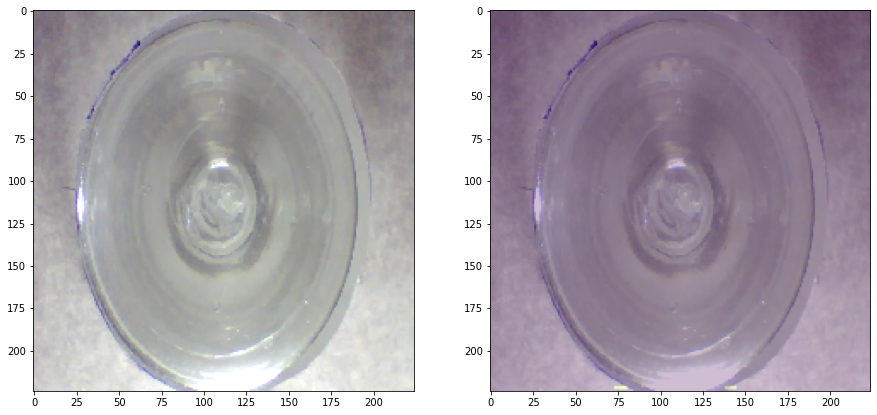

Threshold: 384923.6875 MaxValue: 397033.9375
GT: thread_top, anomaly detected: True


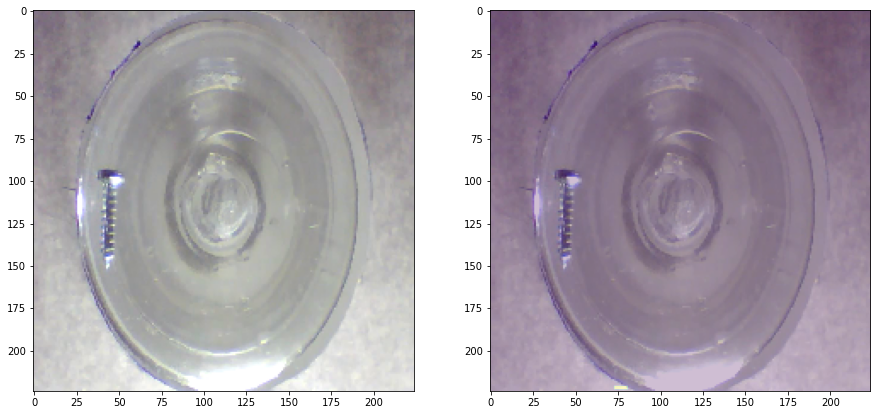

Threshold: 384923.6875 MaxValue: 394755.375
GT: scratch_neck, anomaly detected: True


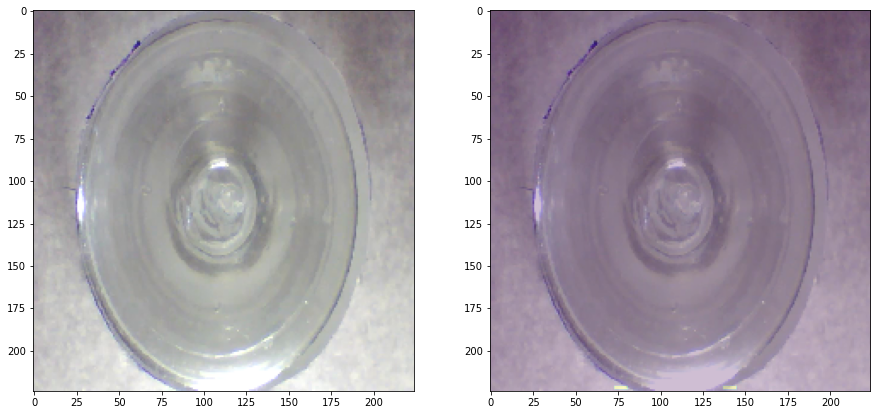

Threshold: 384923.6875 MaxValue: 397351.1875
GT: good, anomaly detected: True


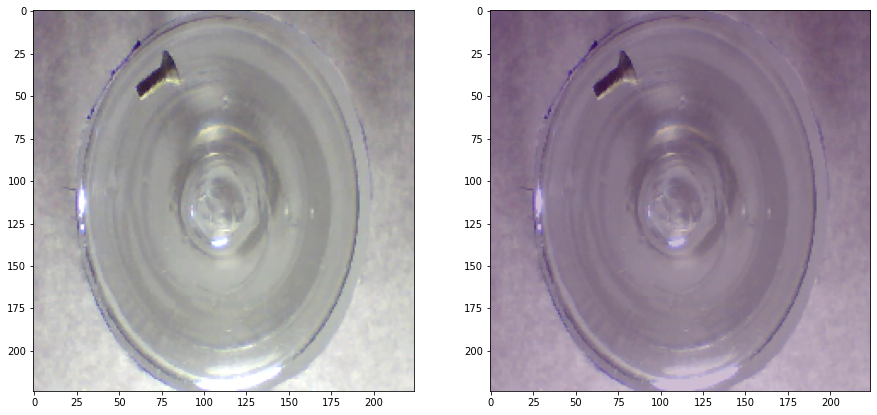

Threshold: 384923.6875 MaxValue: 382778.90625
GT: manipulated_front, anomaly detected: True


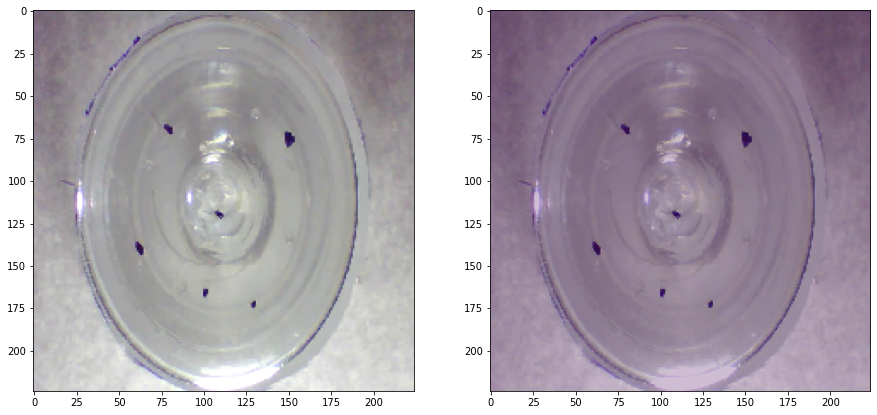

Threshold: 384923.6875 MaxValue: 366109.125
GT: thread_side, anomaly detected: False


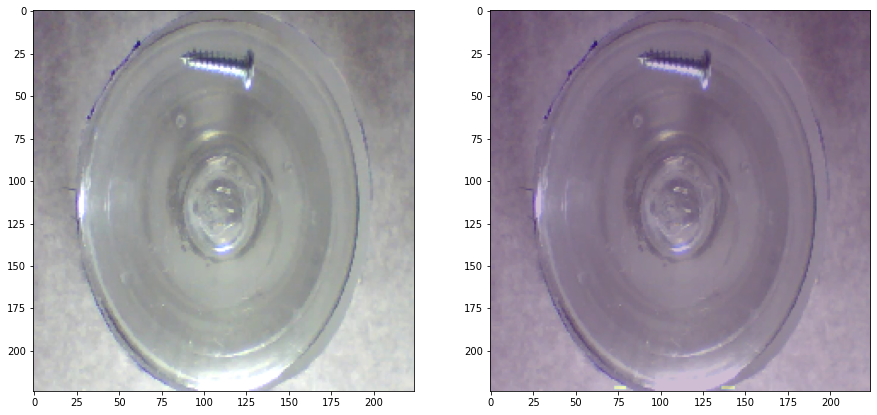

Threshold: 384923.6875 MaxValue: 394864.65625
GT: scratch_neck, anomaly detected: True


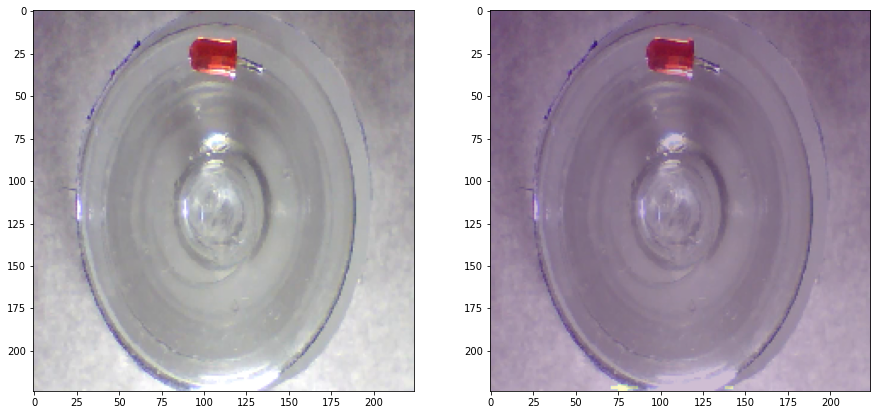

Threshold: 384923.6875 MaxValue: 422808.65625
GT: scratch_head, anomaly detected: True


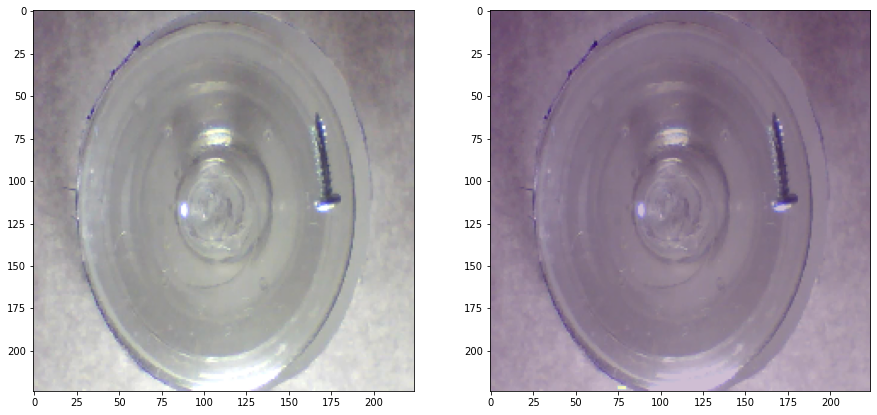

Threshold: 384923.6875 MaxValue: 391381.8125
GT: scratch_head, anomaly detected: True


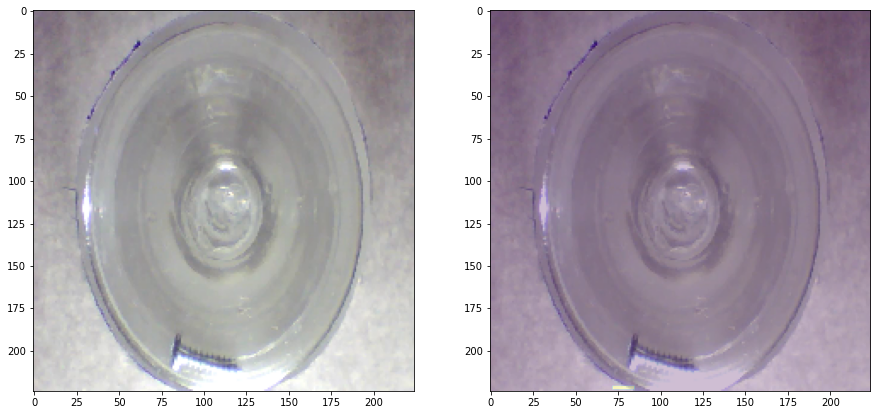

Threshold: 384923.6875 MaxValue: 407647.53125
GT: scratch_neck, anomaly detected: True


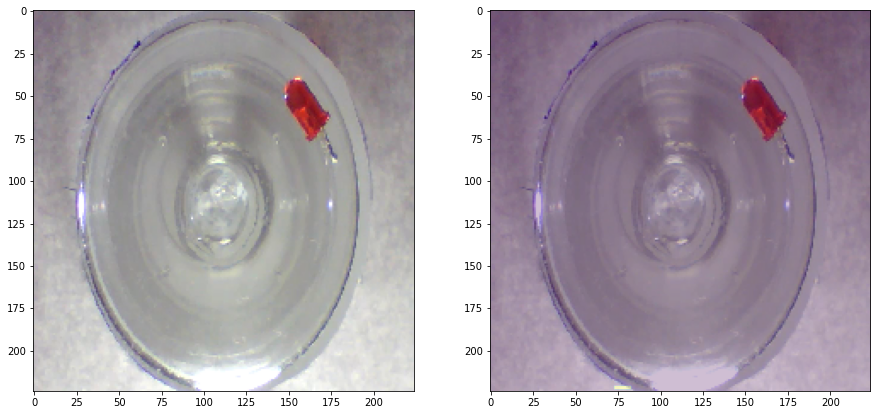

Threshold: 384923.6875 MaxValue: 398482.1875
GT: scratch_neck, anomaly detected: True


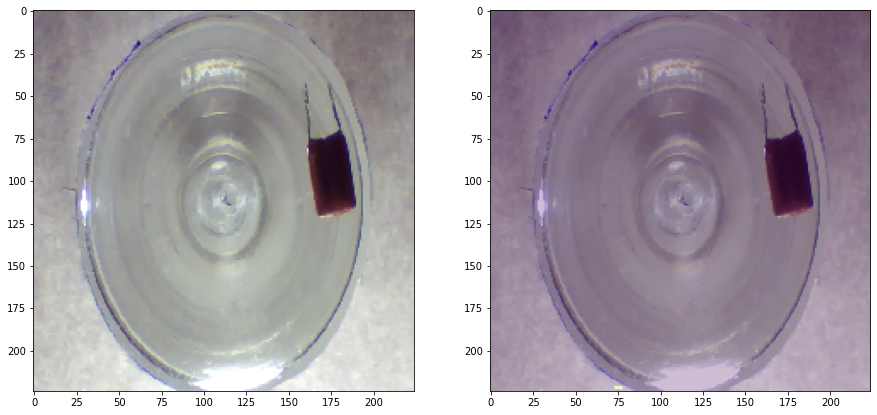

Threshold: 384923.6875 MaxValue: 389880.75
GT: scratch_neck, anomaly detected: True


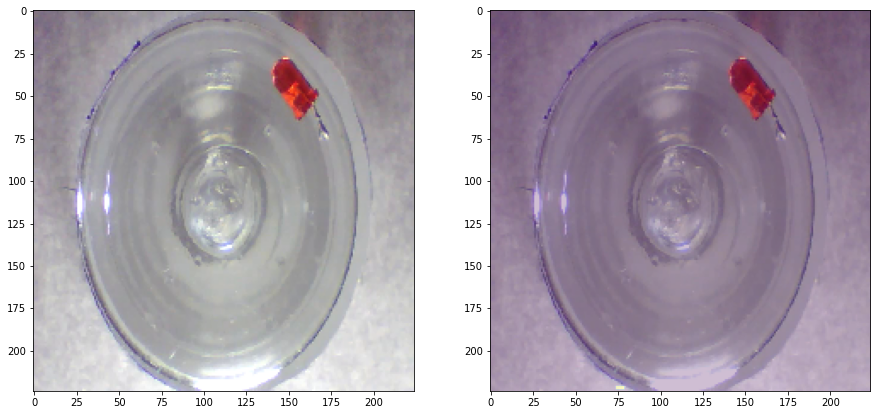

Threshold: 384923.6875 MaxValue: 389128.6875
GT: scratch_neck, anomaly detected: True


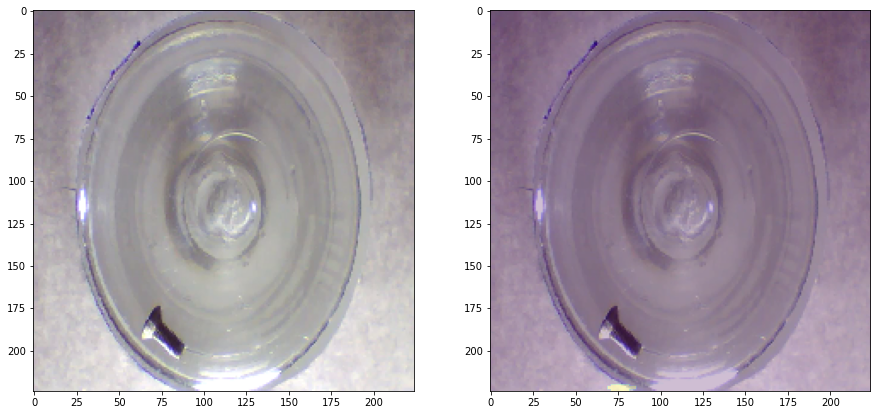

Threshold: 384923.6875 MaxValue: 436621.96875
GT: manipulated_front, anomaly detected: True


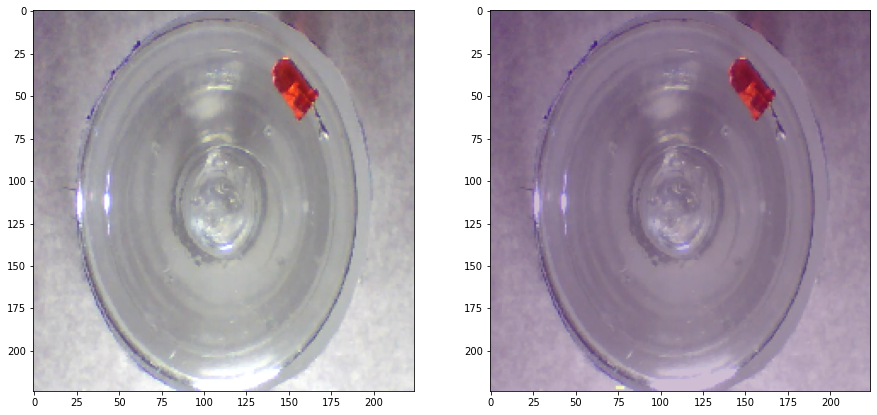

Threshold: 384923.6875 MaxValue: 389892.78125
GT: scratch_neck, anomaly detected: True


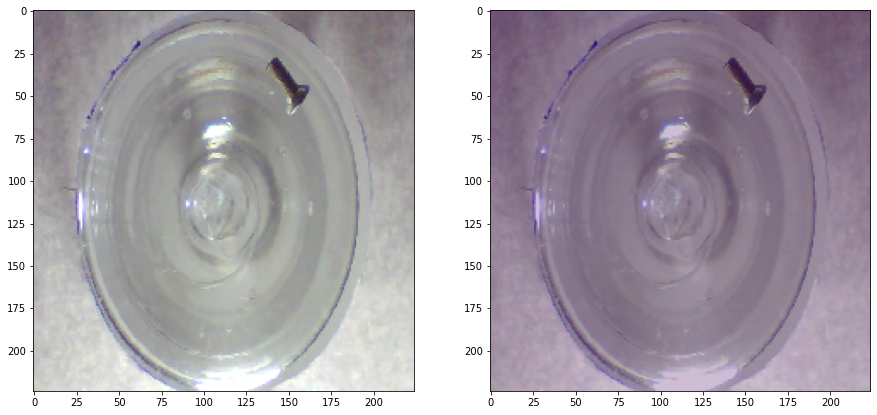

Threshold: 384923.6875 MaxValue: 382019.875
GT: manipulated_front, anomaly detected: True


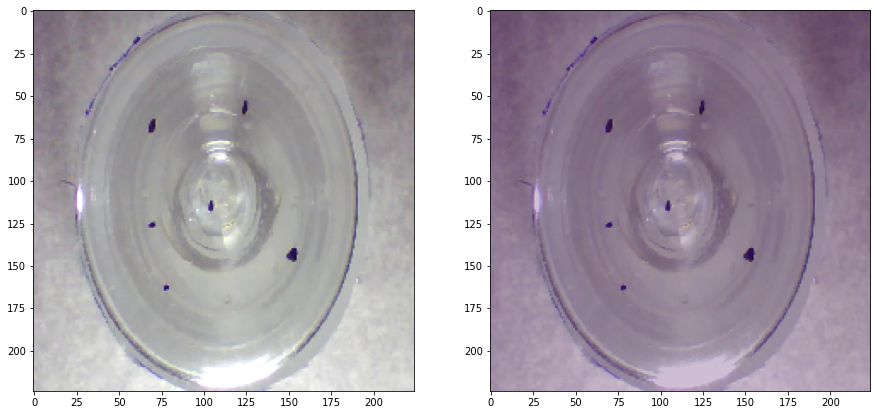

Threshold: 384923.6875 MaxValue: 370462.5625
GT: thread_side, anomaly detected: False


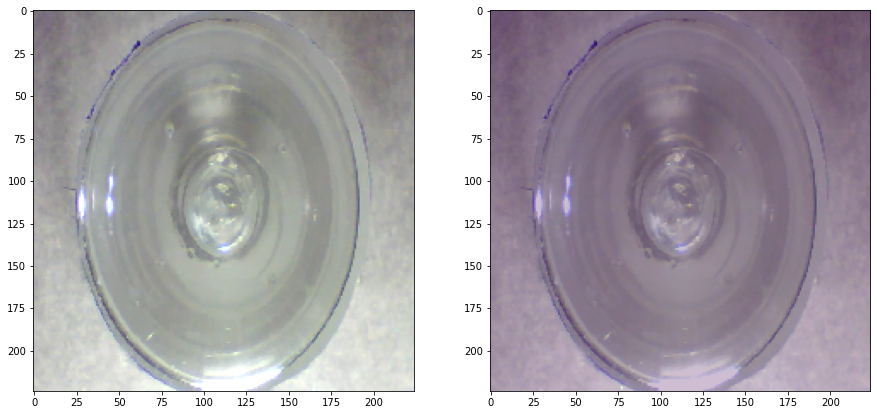

Threshold: 384923.6875 MaxValue: 385170.625
GT: good, anomaly detected: True


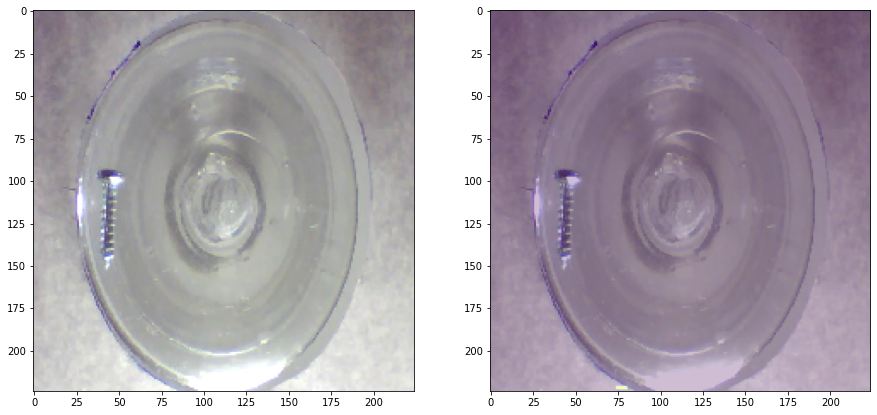

Threshold: 384923.6875 MaxValue: 392854.90625
GT: scratch_head, anomaly detected: True


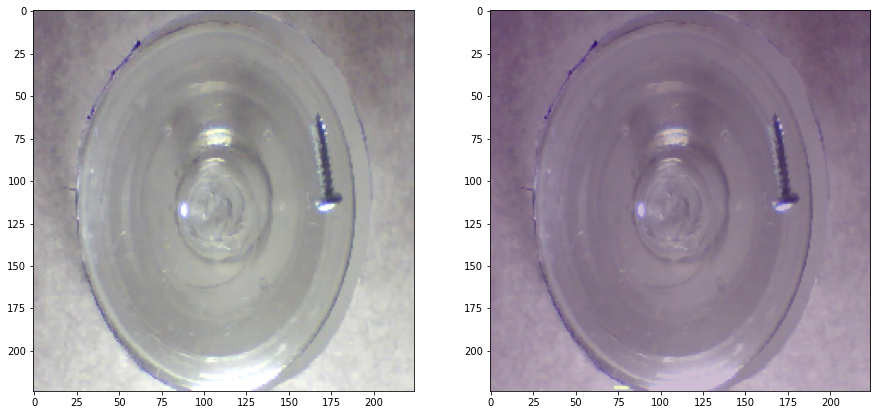

Threshold: 384923.6875 MaxValue: 399823.375
GT: manipulated_front, anomaly detected: True


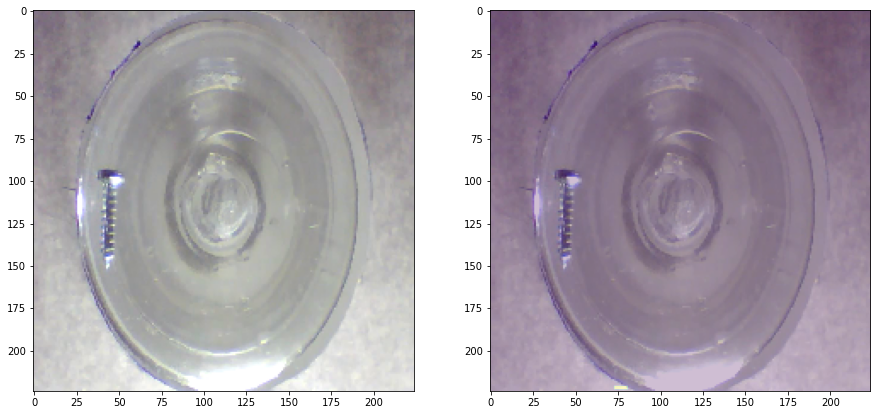

Threshold: 384923.6875 MaxValue: 394755.375
GT: manipulated_front, anomaly detected: True


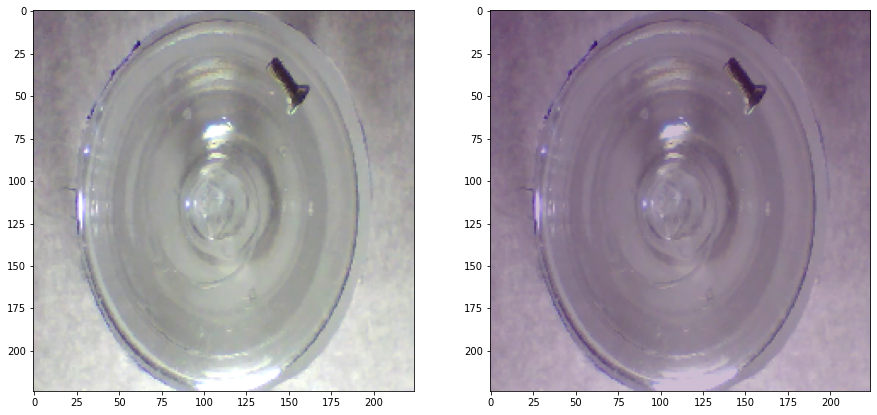

Threshold: 384923.6875 MaxValue: 383609.0625
GT: manipulated_front, anomaly detected: True


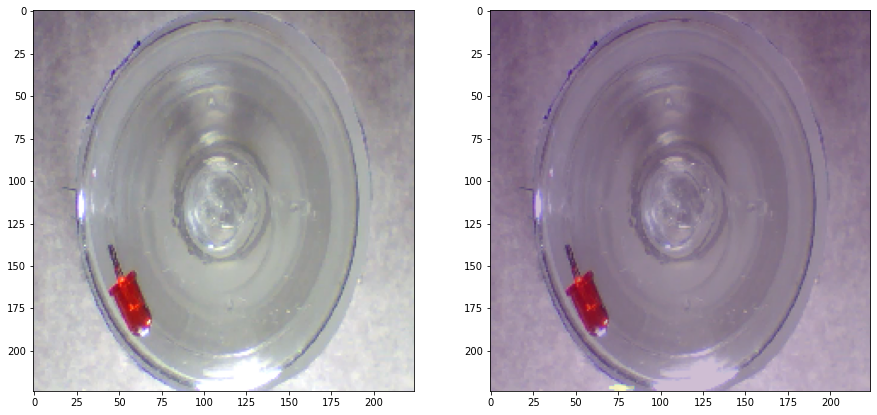

Threshold: 384923.6875 MaxValue: 424769.15625
GT: scratch_head, anomaly detected: True


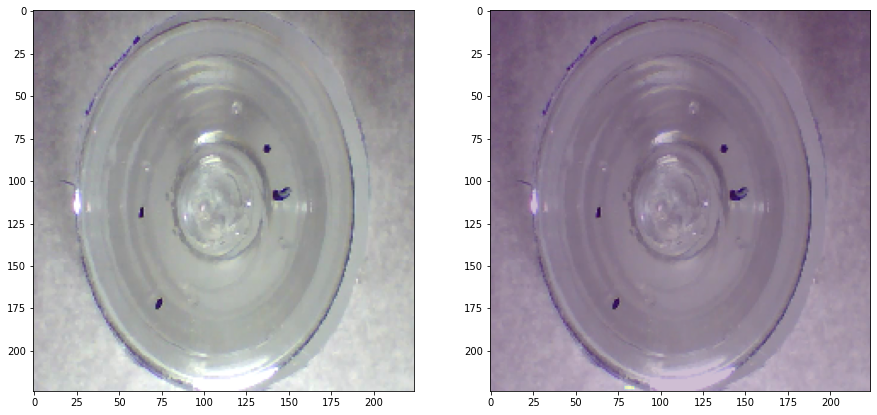

Threshold: 384923.6875 MaxValue: 389965.0
GT: thread_top, anomaly detected: True


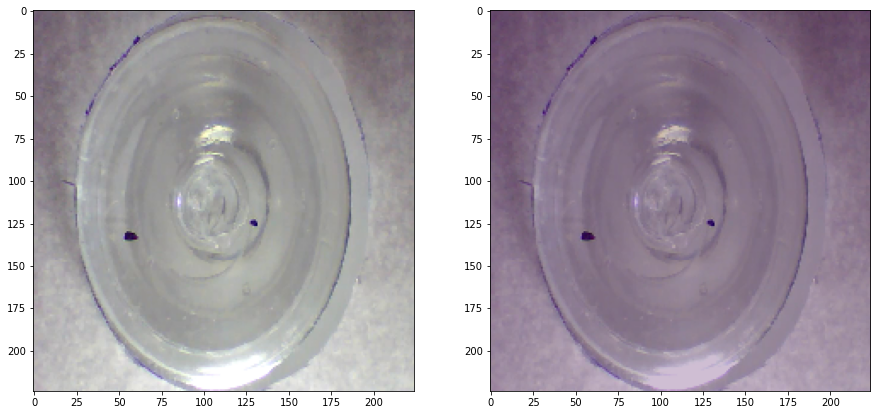

Threshold: 384923.6875 MaxValue: 382949.90625
GT: thread_side, anomaly detected: True


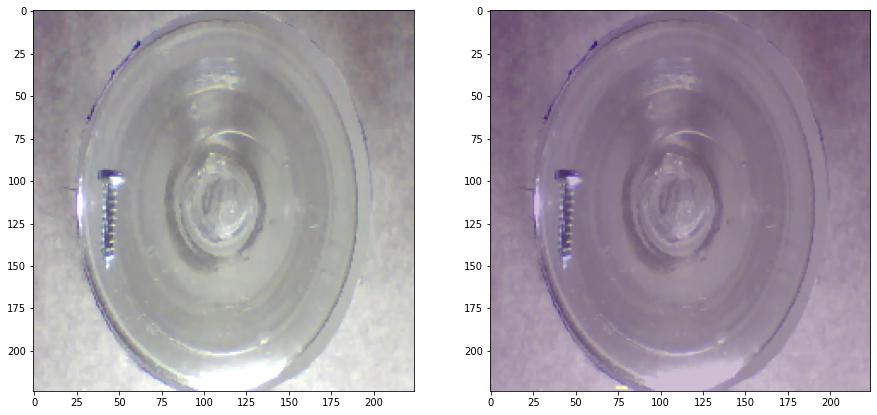

Threshold: 384923.6875 MaxValue: 394840.3125
GT: scratch_neck, anomaly detected: True


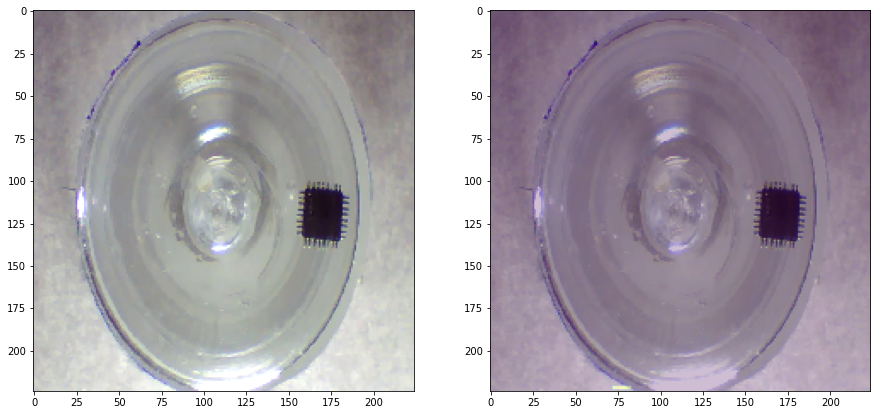

Threshold: 384923.6875 MaxValue: 403258.75
GT: thread_side, anomaly detected: True


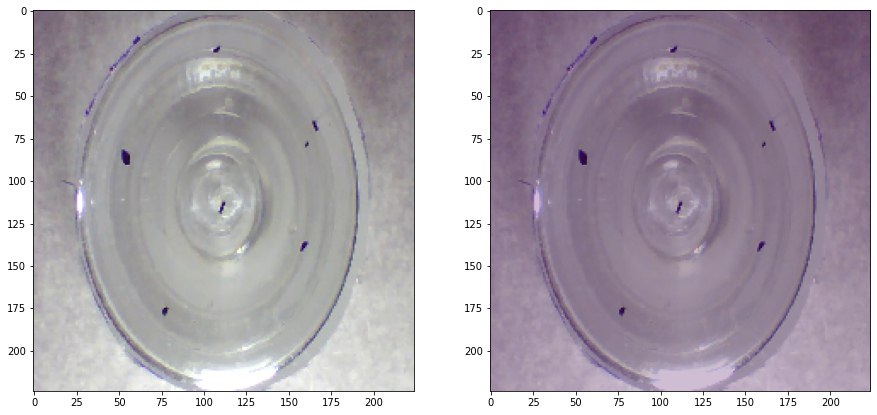

Threshold: 384923.6875 MaxValue: 356054.53125
GT: thread_side, anomaly detected: False


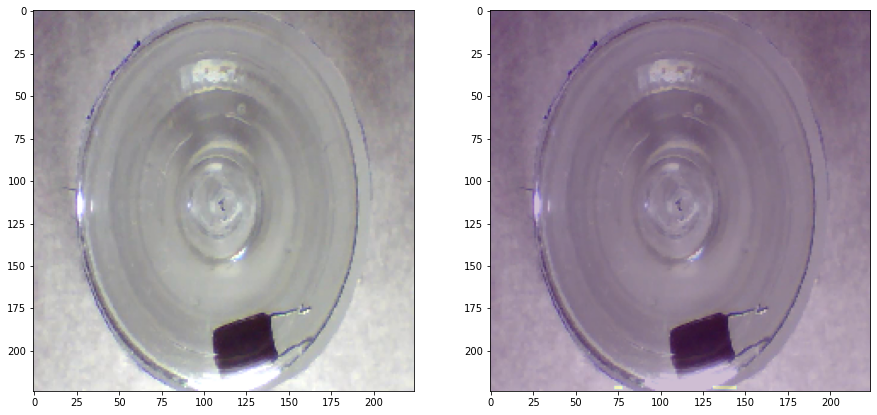

Threshold: 384923.6875 MaxValue: 404086.3125
GT: scratch_neck, anomaly detected: True


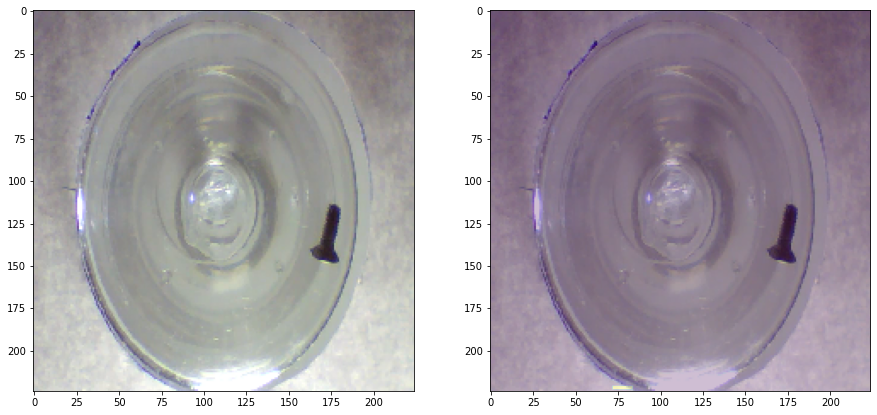

Threshold: 384923.6875 MaxValue: 405768.59375
GT: manipulated_front, anomaly detected: True


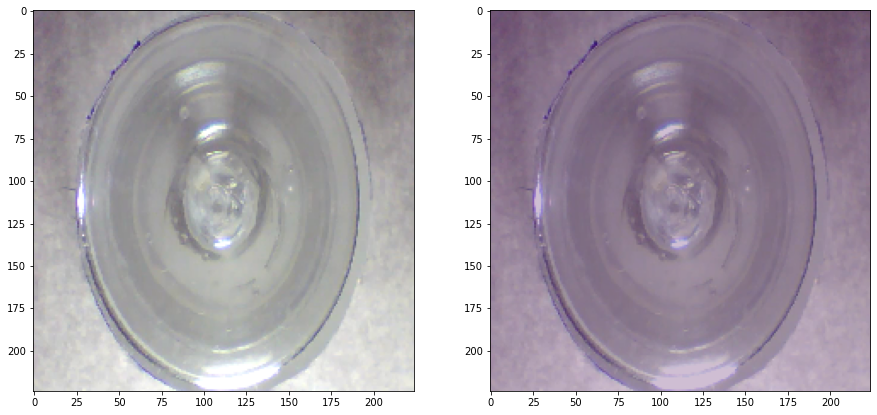

Threshold: 384923.6875 MaxValue: 382321.8125
GT: good, anomaly detected: True


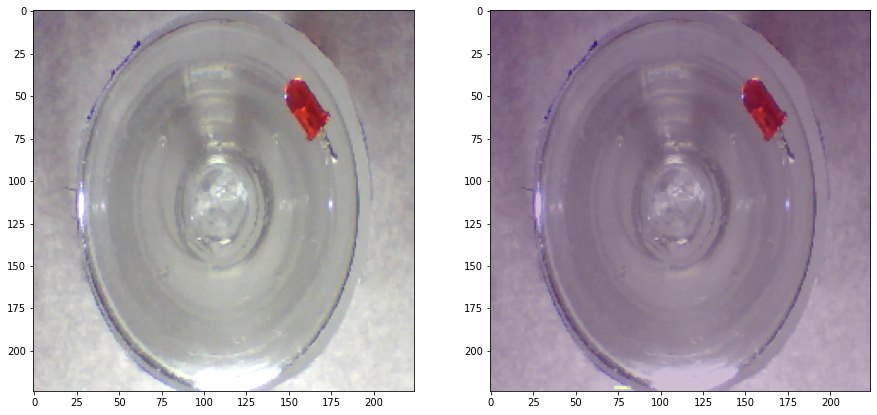

Threshold: 384923.6875 MaxValue: 402074.0
GT: scratch_head, anomaly detected: True


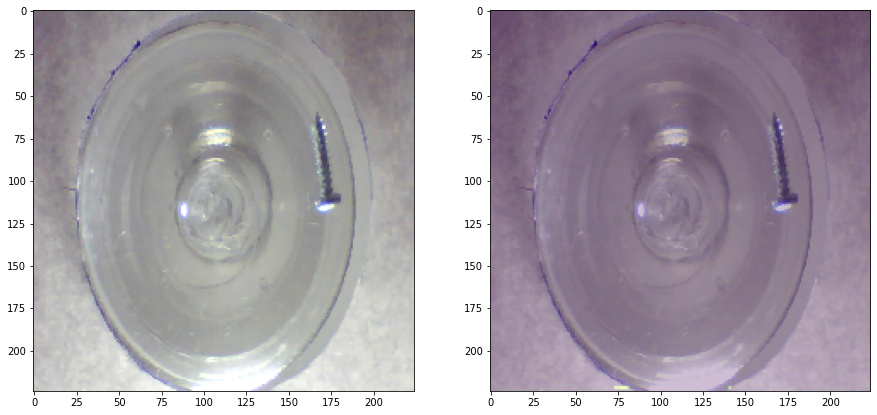

Threshold: 384923.6875 MaxValue: 399835.5
GT: scratch_neck, anomaly detected: True


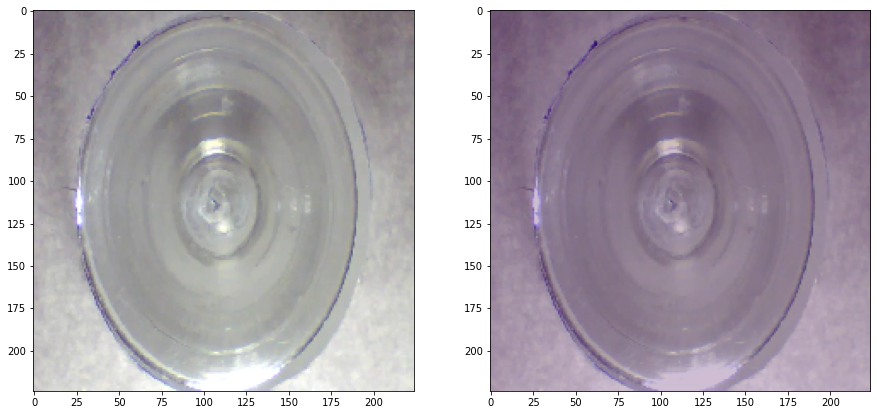

Threshold: 384923.6875 MaxValue: 376921.90625
GT: thread_top, anomaly detected: True


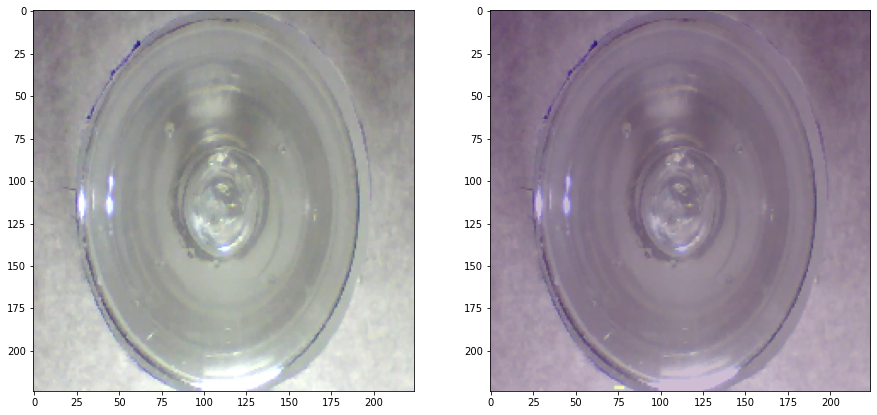

Threshold: 384923.6875 MaxValue: 390939.0625
GT: thread_top, anomaly detected: True


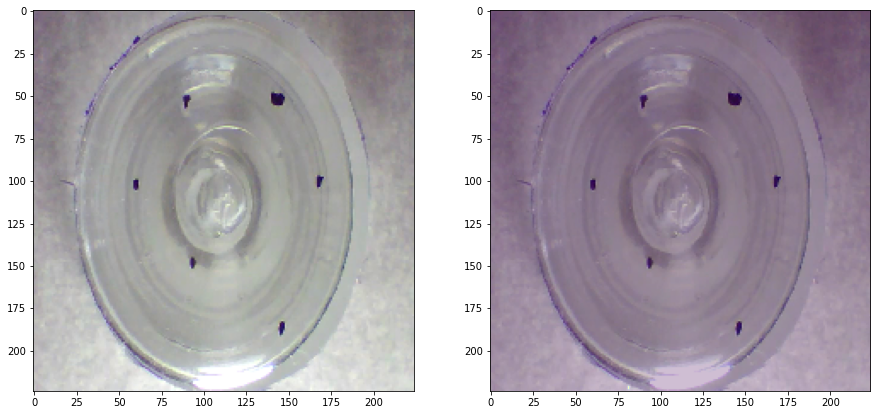

Threshold: 384923.6875 MaxValue: 385298.9375
GT: thread_side, anomaly detected: True


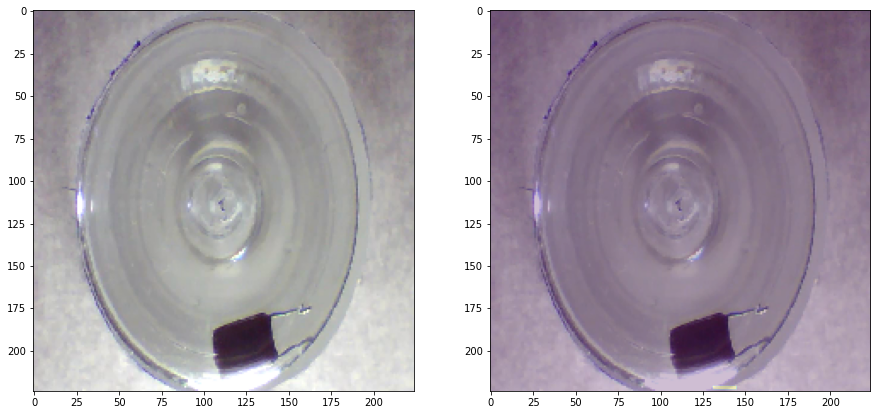

Threshold: 384923.6875 MaxValue: 403985.875
GT: scratch_neck, anomaly detected: True


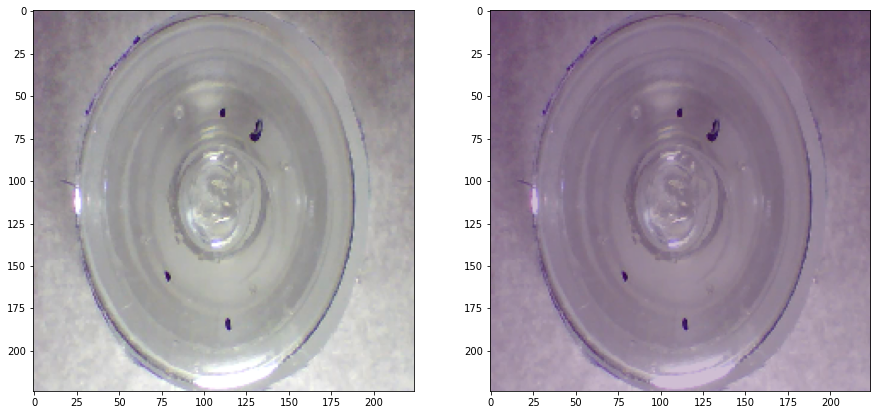

Threshold: 384923.6875 MaxValue: 355820.3125
GT: thread_side, anomaly detected: False


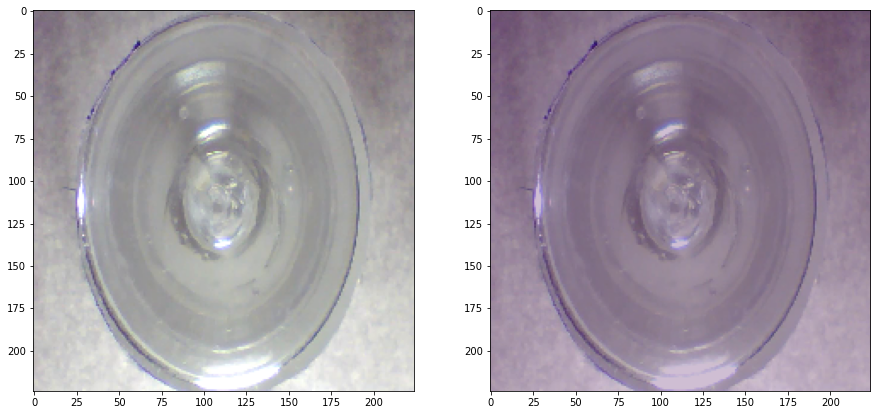

Threshold: 384923.6875 MaxValue: 381345.84375
GT: thread_top, anomaly detected: True


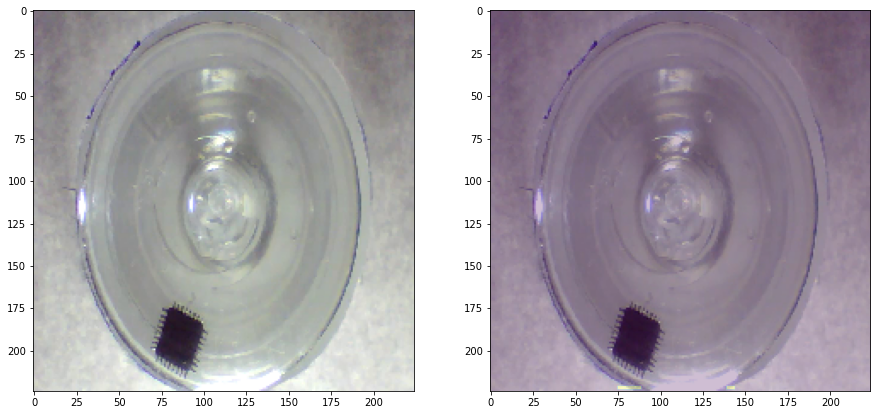

Threshold: 384923.6875 MaxValue: 400411.46875
GT: scratch_neck, anomaly detected: True


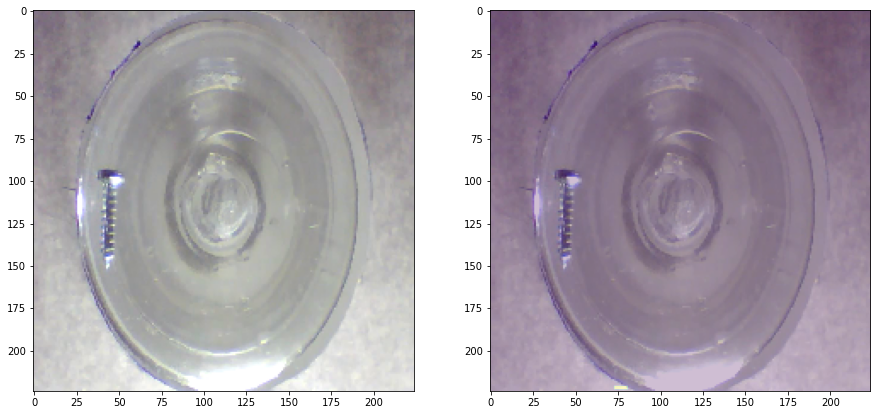

Threshold: 384923.6875 MaxValue: 394755.375
GT: scratch_head, anomaly detected: True


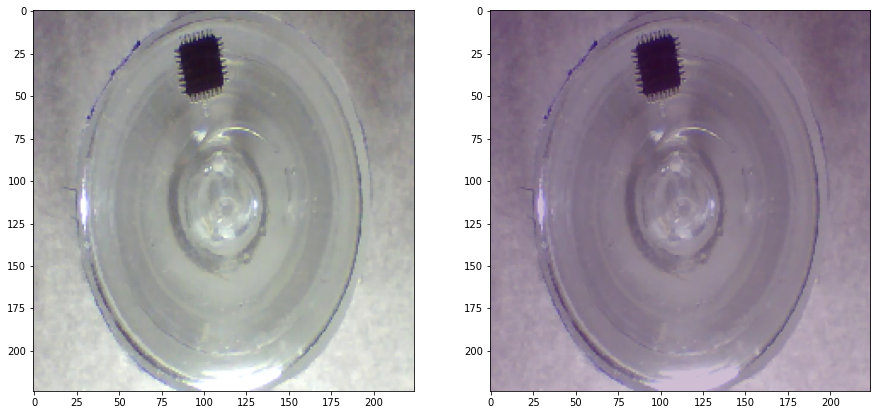

Threshold: 384923.6875 MaxValue: 380995.625
GT: thread_top, anomaly detected: True


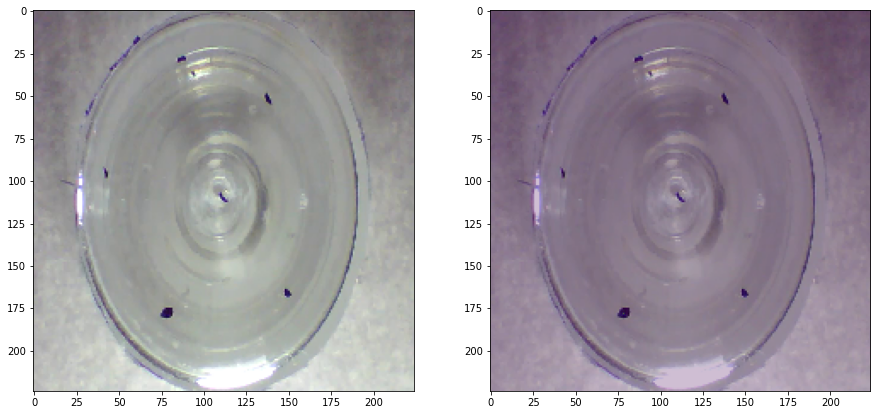

Threshold: 384923.6875 MaxValue: 387789.8125
GT: thread_side, anomaly detected: True


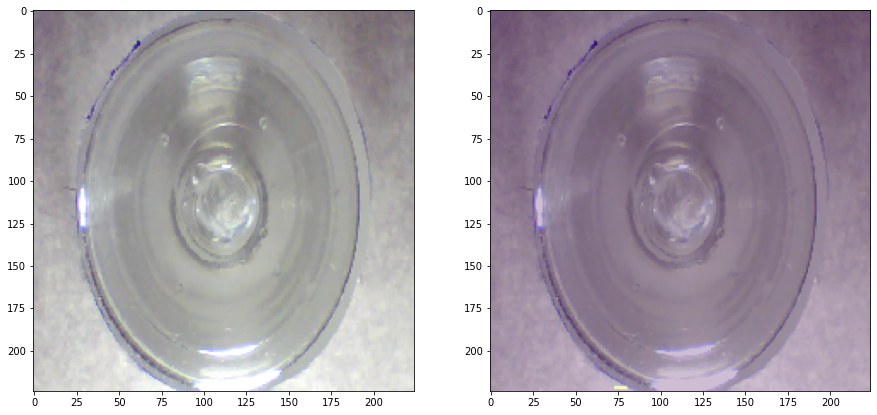

Threshold: 384923.6875 MaxValue: 396352.71875
GT: thread_top, anomaly detected: True


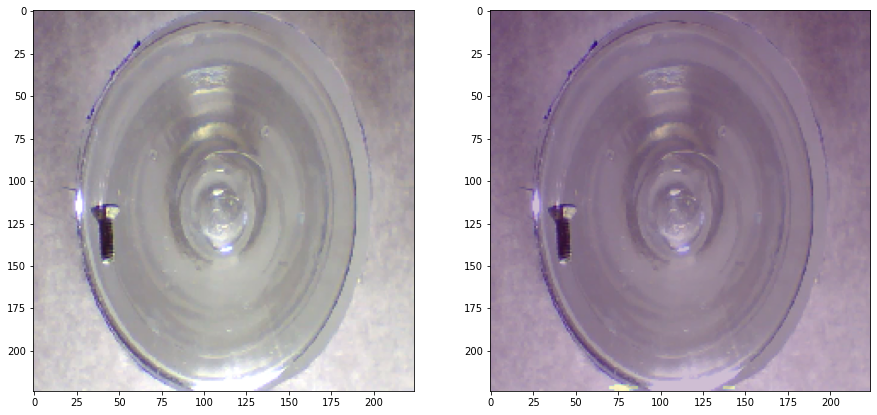

Threshold: 384923.6875 MaxValue: 427439.65625
GT: manipulated_front, anomaly detected: True


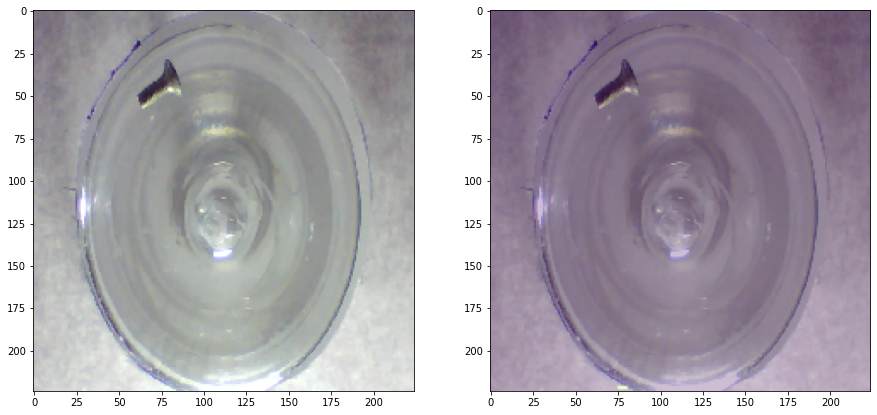

Threshold: 384923.6875 MaxValue: 391138.75
GT: manipulated_front, anomaly detected: True


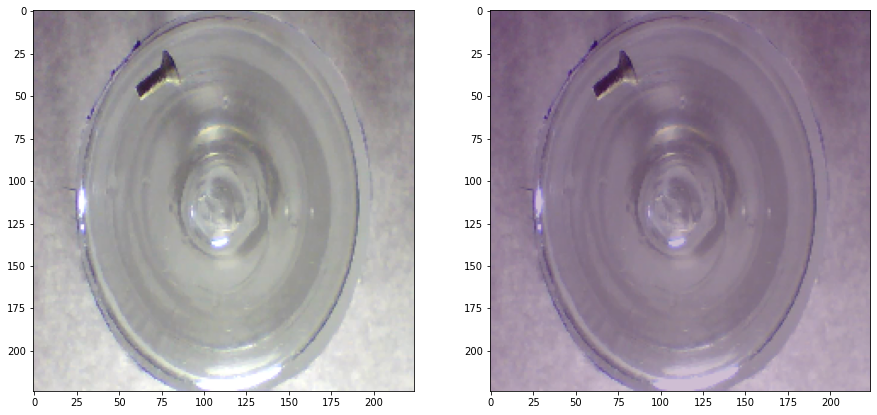

Threshold: 384923.6875 MaxValue: 382184.15625
GT: manipulated_front, anomaly detected: True


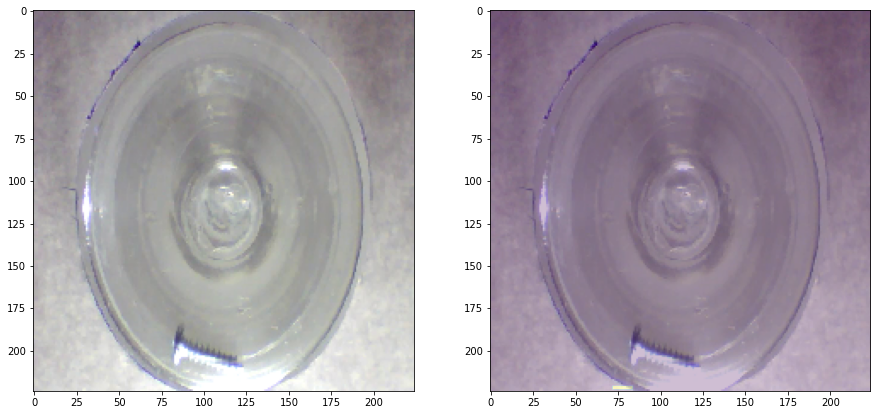

Threshold: 384923.6875 MaxValue: 409165.8125
GT: scratch_neck, anomaly detected: True


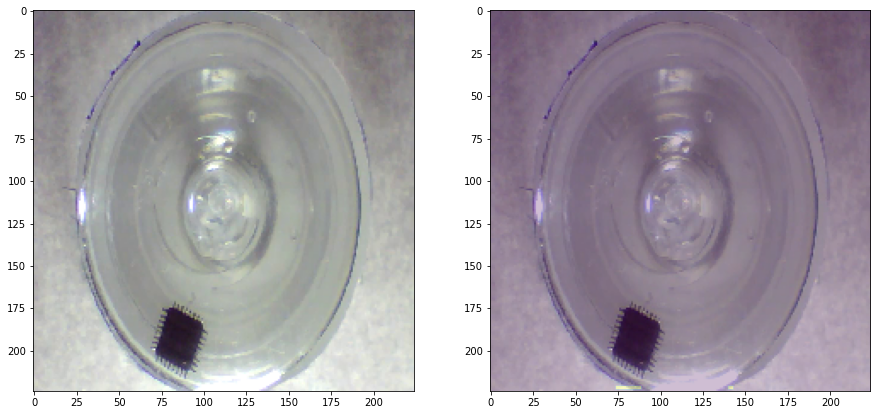

Threshold: 384923.6875 MaxValue: 402167.09375
GT: scratch_neck, anomaly detected: True


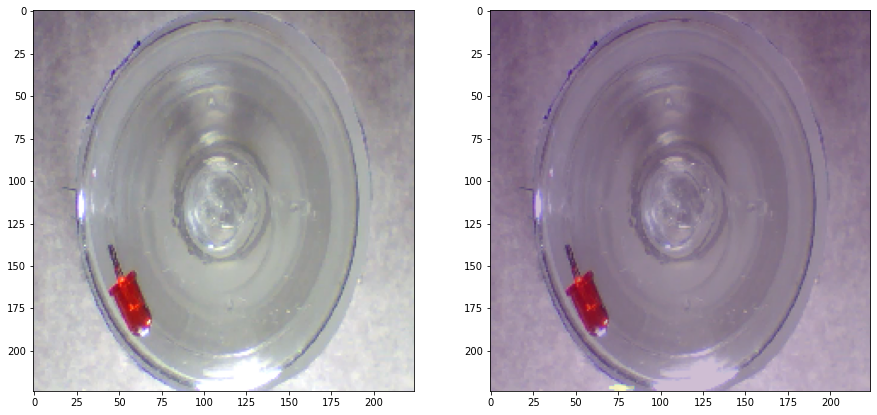

Threshold: 384923.6875 MaxValue: 424769.15625
GT: scratch_neck, anomaly detected: True


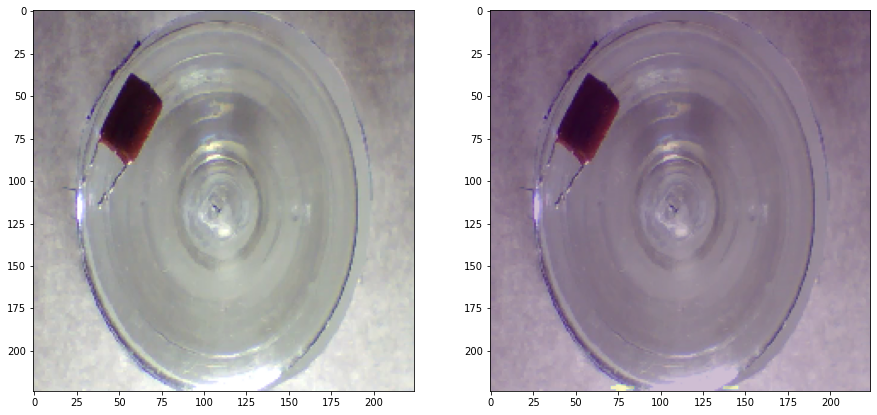

Threshold: 384923.6875 MaxValue: 419588.09375
GT: scratch_neck, anomaly detected: True


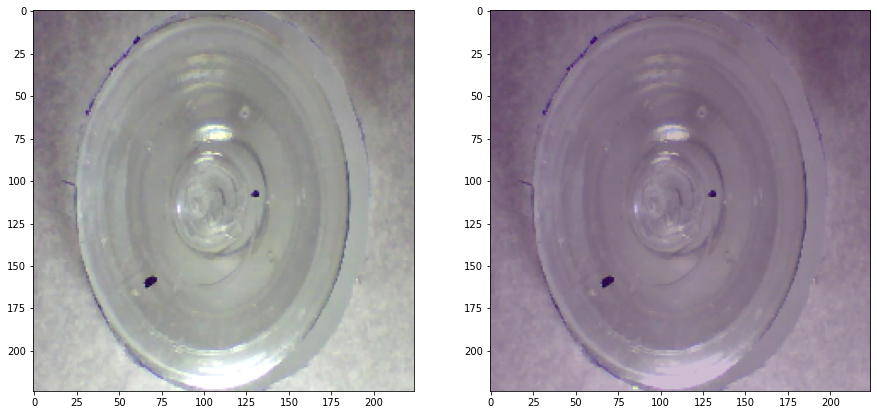

Threshold: 384923.6875 MaxValue: 385682.53125
GT: thread_side, anomaly detected: True


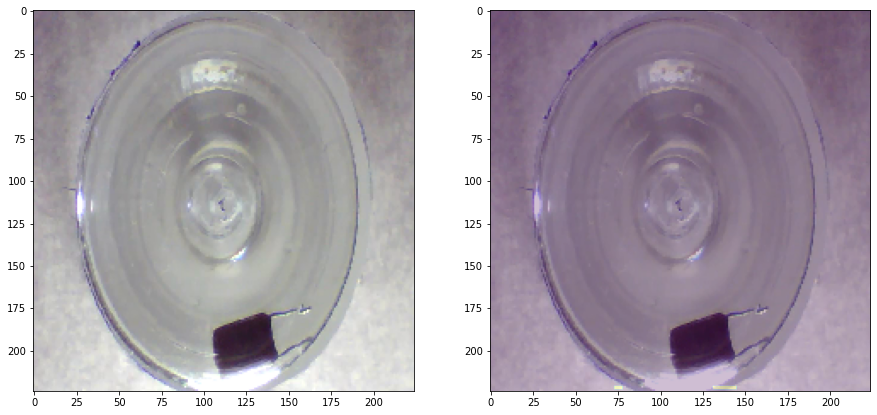

Threshold: 384923.6875 MaxValue: 403523.25
GT: scratch_neck, anomaly detected: True


In [32]:
for i in range(100):
    x_batch, y_batch = next(test_generator)    
    hotmaps = as_model(x_batch)
    for x, y, hotmap in zip(x_batch, y_batch, hotmaps):

        prediction = np.any(hotmap > as_model.threshold)

        hotmap = resize(hotmap, x.shape[:-1], anti_aliasing = True)
        mask = np.where(hotmap > as_model.threshold, 1, 0)
        

        f, axarr = plt.subplots(1,2, figsize=(15,15))
        axarr[0].imshow(x)
        axarr[1].imshow(mask)
        axarr[1].imshow(x, alpha = 0.75)
        plt.show()

        print(f"Threshold: {as_model.threshold.numpy()} MaxValue: {hotmap.max()}")
        print(f"GT: {classes[int(y)]}, anomaly detected: {prediction}")
    